In [1]:
from astropy.io import ascii 
from astropy.table import Table
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from astropy.coordinates import SkyCoord
from astropy import units as u
# from astropy.cosmology import WMAP9 as cosmo
from astropy.modeling import models, fitting
import os
import pickle
from scipy.optimize import curve_fit
from astropy.cosmology import FlatLambdaCDM
cosmo = FlatLambdaCDM(H0=70, Om0=0.3)

In [2]:
data = Table.read("HorizonAGN_LAIGLE.fits")

In [3]:
data.keys()

['ID',
 'RA_true',
 'DEC_true',
 'z_true',
 'z_dist',
 'MASS_true',
 'MASSBC03_true',
 'SFR_true',
 'MASS-WEIGHTED_AGE_true',
 'METALLICITY_true',
 'ZMED_sedf',
 'ZMED_UP_sedf',
 'ZMED_DOWN_sedf',
 'ZBEST_sedf',
 'ZBEST_UP_sedf',
 'ZBEST_DOWN_sedf',
 'MMED_sedf',
 'MMED_UP_sedf',
 'MMED_DOWN_sedf',
 'MBEST_sedf',
 'SFRMED_sedf',
 'SFRMED_UP_sedf',
 'SFRMED_DOWN_sedf',
 'LNUV_BEST_sedf',
 'LR_BEST_sedf',
 'LK_BEST_sedf',
 'MNUV_TOT_true',
 'MR_TOT_true',
 'MKs_TOT_true',
 'EXTLAW_BEST_sedf',
 'EBV_BEST_sedf',
 'u_TOT',
 'u_TOT_ERR',
 'u_TOTnoerr',
 'B_TOT',
 'B_TOT_ERR',
 'B_TOTnoerr',
 'V_TOT',
 'V_TOT_ERR',
 'V_TOTnoerr',
 'r_TOT',
 'r_TOT_ERR',
 'r_TOTnoerr',
 'ip_TOT',
 'ip_TOT_ERR',
 'ip_TOTnoerr',
 'zpp_TOT',
 'zpp_TOT_ERR',
 'zpp_TOTnoerr',
 'Y_TOT',
 'Y_TOT_ERR',
 'Y_TOTnoerr',
 'J_TOT',
 'J_TOT_ERR',
 'J_TOTnoerr',
 'H_TOT',
 'H_TOT_ERR',
 'H_TOTnoerr',
 'Ks_TOT',
 'Ks_TOT_ERR',
 'Ks_TOTnoerr',
 'IA427_TOT',
 'IA427_TOT_ERR',
 'IA427_TOTnoerr',
 'IA464_TOT',
 'IA464_TOT_ERR',
 

In [4]:
len(data)

789354

(array([ 17487.,  63891., 101399., 127612., 130598., 116490.,  90916.,
         68856.,  45494.,  26611.]),
 array([0.06357503, 0.45721613, 0.85085722, 1.24449832, 1.63813942,
        2.03178051, 2.42542161, 2.81906271, 3.21270381, 3.6063449 ,
        3.999986  ]),
 <BarContainer object of 10 artists>)

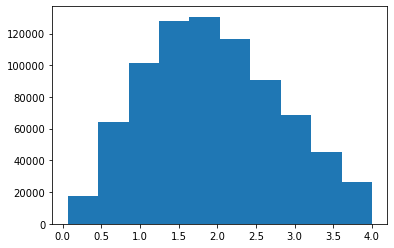

In [5]:
plt.hist(data['z_true'])

# Load catalog & functions

In [6]:
#find grid step: 100kpc
def find_grid_step(z):
    sep = cosmo.arcsec_per_kpc_proper(z) * 100 * u.kpc
    return sep.to(u.deg).value

#find bin size
def find_bin_size(z):
    del_z = 0.015 * (1+z)
    return del_z

#find search radius: 700kpc
def find_search_radius(z):
    r = cosmo.arcsec_per_kpc_proper(z) * 700 * u.kpc # arcsec
    
    return r.to(u.deg).value

#find redshift increment next to z
def find_bin_step(z):
    closest = 0
    compare_v = 100
    
    for i in np.arange(z+0.03, z, -0.00001):
        v = cosmo.H0 * (cosmo.comoving_distance(i) - cosmo.comoving_distance(z)) 
#         
        if np.abs(v.value - 1500) < compare_v:
            closest = i
            compare_v = np.abs(v.value - 1500)
#             print(compare_v, end = ' ')
    #return next z
    return closest



In [7]:
# data['Mass_true']
# data.keys()
data = data[data['MASS_true'] >= 9.54]

In [8]:
len(data)
data.keys()

['ID',
 'RA_true',
 'DEC_true',
 'z_true',
 'z_dist',
 'MASS_true',
 'MASSBC03_true',
 'SFR_true',
 'MASS-WEIGHTED_AGE_true',
 'METALLICITY_true',
 'ZMED_sedf',
 'ZMED_UP_sedf',
 'ZMED_DOWN_sedf',
 'ZBEST_sedf',
 'ZBEST_UP_sedf',
 'ZBEST_DOWN_sedf',
 'MMED_sedf',
 'MMED_UP_sedf',
 'MMED_DOWN_sedf',
 'MBEST_sedf',
 'SFRMED_sedf',
 'SFRMED_UP_sedf',
 'SFRMED_DOWN_sedf',
 'LNUV_BEST_sedf',
 'LR_BEST_sedf',
 'LK_BEST_sedf',
 'MNUV_TOT_true',
 'MR_TOT_true',
 'MKs_TOT_true',
 'EXTLAW_BEST_sedf',
 'EBV_BEST_sedf',
 'u_TOT',
 'u_TOT_ERR',
 'u_TOTnoerr',
 'B_TOT',
 'B_TOT_ERR',
 'B_TOTnoerr',
 'V_TOT',
 'V_TOT_ERR',
 'V_TOTnoerr',
 'r_TOT',
 'r_TOT_ERR',
 'r_TOTnoerr',
 'ip_TOT',
 'ip_TOT_ERR',
 'ip_TOTnoerr',
 'zpp_TOT',
 'zpp_TOT_ERR',
 'zpp_TOTnoerr',
 'Y_TOT',
 'Y_TOT_ERR',
 'Y_TOTnoerr',
 'J_TOT',
 'J_TOT_ERR',
 'J_TOTnoerr',
 'H_TOT',
 'H_TOT_ERR',
 'H_TOTnoerr',
 'Ks_TOT',
 'Ks_TOT_ERR',
 'Ks_TOTnoerr',
 'IA427_TOT',
 'IA427_TOT_ERR',
 'IA427_TOTnoerr',
 'IA464_TOT',
 'IA464_TOT_ERR',
 

In [9]:
redshifts = np.arange(0.6, 1.22, 0.01)
len(redshifts)

62

In [10]:
binsize = find_bin_size(redshifts)

# Density field construction

In [16]:
# consctruct density field
def construction(idx):
    bs = binsize[idx] #binsize
    z = redshifts[idx]
    zrange = data[(data['z_true'] <=  z + bs) & (data['z_true'] >= z - bs)]
    
    print(f'{z : .4f}', end = ' ')
    
    #grid separation = 0.1Mpc
    gstep = find_grid_step(z)
    grid_ra = np.arange(min(zrange['RA_true']), max(zrange['RA_true']), gstep)
    grid_dec = np.arange(min(zrange['DEC_true']), max(zrange['DEC_true']), gstep)
    
    grid = np.zeros((len(grid_dec), len(grid_ra)))
    
    print(len(grid_dec))
    for j in range(len(grid_ra)):
#         if(i % 100 == 0):
#             print(i)
        for i in range(len(grid_dec)):
            #within 1Mpc, z -> z_cl +- error
            sr = find_search_radius(z)
            
            sample = zrange[((zrange['RA_true'] -  grid_ra[j])**2 + (zrange['DEC_true'] - grid_dec[i])**2 < sr**2)]
            grid[i, j] = len(sample)
    
    print(grid.shape)
    np.save(f'./mock/bins_{idx:03d}', grid)        
    
    print(f'{z} completed')

In [17]:
import multiprocessing as mp

In [18]:
n = 5 #number of cores to use
with mp.Pool(n) as p:
    p.map(construction, range(len(redshifts)))

 0.7600  0.6000 0.6800   0.7200  0.6400 241
254
266
261
248
(241, 241)
0.6 completed
 0.6100 243
(248, 248)
0.64 completed
 0.6500 250
(254, 255)
0.68 completed
 0.6900 256
(261, 261)
0.7200000000000001 completed
 0.7300 262
(266, 266)
0.7600000000000001 completed
 0.7700 267
(243, 243)
0.61 completed
 0.6200 245
(250, 249)
0.65 completed
 0.6600 252
(256, 256)
0.6900000000000001 completed
 0.7000 258
(262, 262)
0.7300000000000001 completed
 0.7400 263
(267, 267)
0.7700000000000001 completed
 0.7800 268
(245, 245)
0.62 completed
 0.6300 247
(252, 251)
0.66 completed
 0.6700 253
(258, 258)
0.7000000000000001 completed
 0.7100 259
(263, 263)
0.7400000000000001 completed
 0.7500 264
(268, 268)
0.7800000000000001 completed
 0.7900 270
(247, 246)
0.63 completed
 0.8000 271
(253, 253)
0.67 completed
 0.8400 275
(259, 259)
0.7100000000000001 completed
 0.8800 279
(264, 265)
0.7500000000000001 completed
 0.9200 283
(270, 270)
0.7900000000000001 completed
 0.9600 286
(271, 271)
0.80000000000000

In [19]:
file_list = os.listdir(f'./mock/')
file_list.sort()

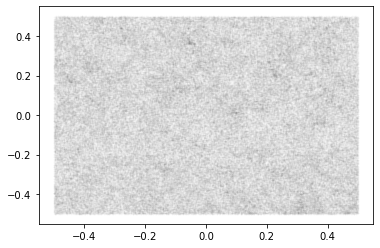

In [28]:
plt.scatter(data['RA_true'], data['DEC_true'], color = 'grey', s = 1, alpha = .01)

In [29]:
def densityfield(i, n = 10):
    print(i, end = ' ')
    grid = np.load('./mock/' + file_list[i])


    bs = binsize[i] #binsize
    z = redshifts[i]
    zrange = data[(data['z_true'] <=  z + bs) & (data['z_true'] >= z - bs)]

    print(f'{z : .4f}', end = ' ')

    #grid separation = 0.1Mpc
    gstep = find_grid_step(z)
    grid_ra = np.arange(min(zrange['RA_true']), max(zrange['RA_true']), gstep)
    grid_dec = np.arange(min(zrange['DEC_true']), max(zrange['DEC_true']), gstep)

    grid_x, grid_y = np.meshgrid(grid_ra, grid_dec)

    np.save(f'./mock/grid_x/gird_x_{i:03d}', grid_x)
    np.save(f'./mock/grid_y/gird_y_{i:03d}', grid_y)


    print('successfully saved!')

In [30]:
#multi processing
with mp.Pool(6) as p:
    print(p.map(densityfield, range(len(redshifts))))

61215309       0.6300  0.6000  0.7500 0.7200   0.6900  0.6600 successfully saved!
4 successfully saved!
1 successfully saved!
16successfully saved! 
10 successfully saved!
 0.640013 0.6100   successfully saved!
7 0.7600   0.7000 successfully saved!
5 successfully saved!
2 0.7300   0.6700 successfully saved!
17 successfully saved!
11  0.6500  0.6200 successfully saved!
8successfully saved! 
 0.770014   0.7100successfully saved! 
18 successfully saved!
21  0.6800  0.7400 successfully saved!
24successfully saved! 
27  0.7800successfully saved! 0.8100 
 30 successfully saved!
33  0.8400  0.8700 successfully saved!
19 successfully saved!
22  0.9000 successfully saved!
25 successfully saved! 0.9300
  0.790028   0.8200  0.8500 successfully saved!
31successfully saved! 0.8800  
20 successfully saved!
23 successfully saved!
34 successfully saved!
26 0.8000   0.9100 successfully saved!
29  0.8300  0.9400  0.8600 successfully saved!
36 successfully saved! 0.8900
 32 successfully saved!
39 success

In [11]:
file_list = os.listdir(f'./mock/')
file_list.sort()

xlist = os.listdir('./mock/grid_x/')
ylist = os.listdir('./mock/grid_y/')

xlist.sort()
ylist.sort()

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 

/home/ehko/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 

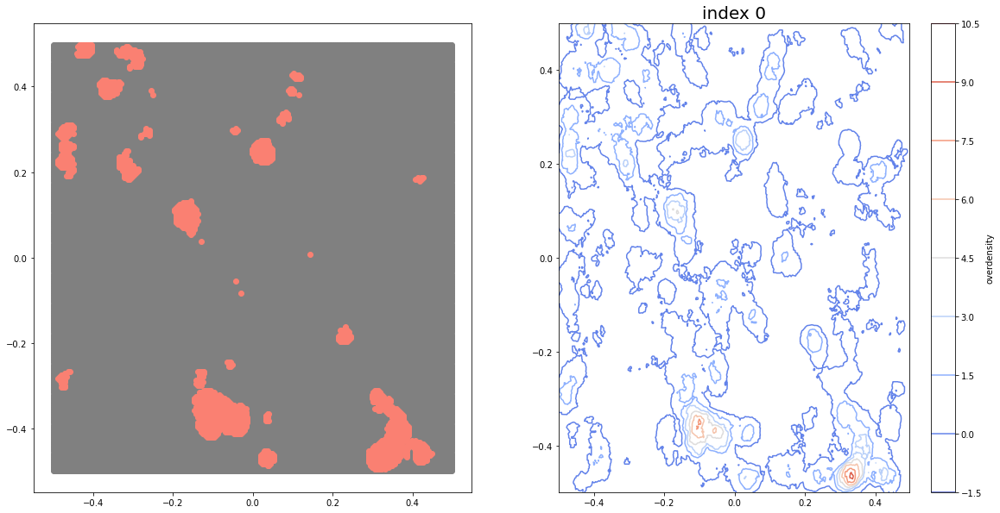

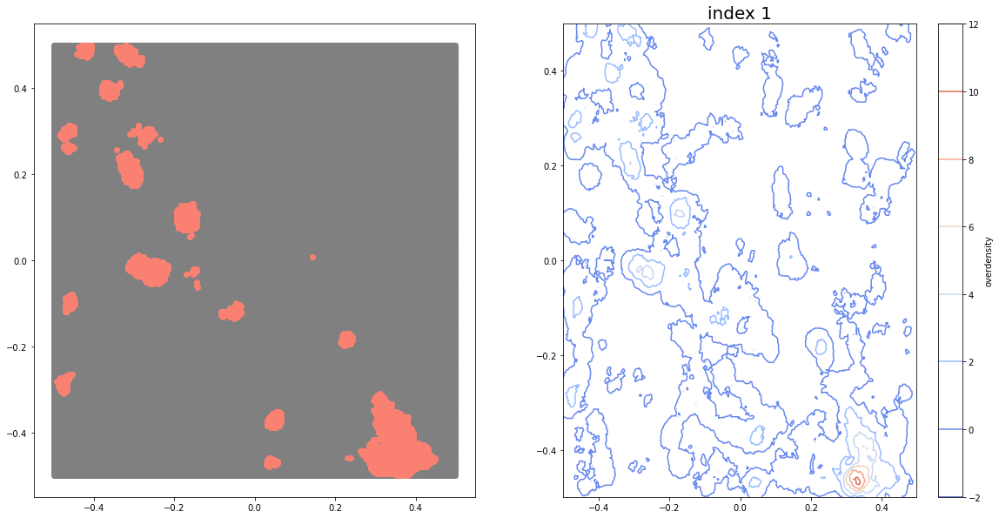

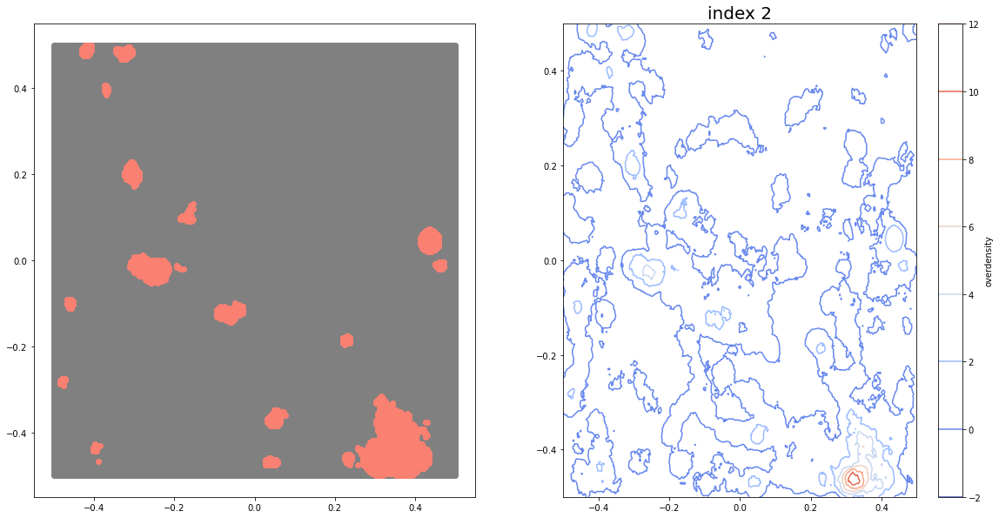

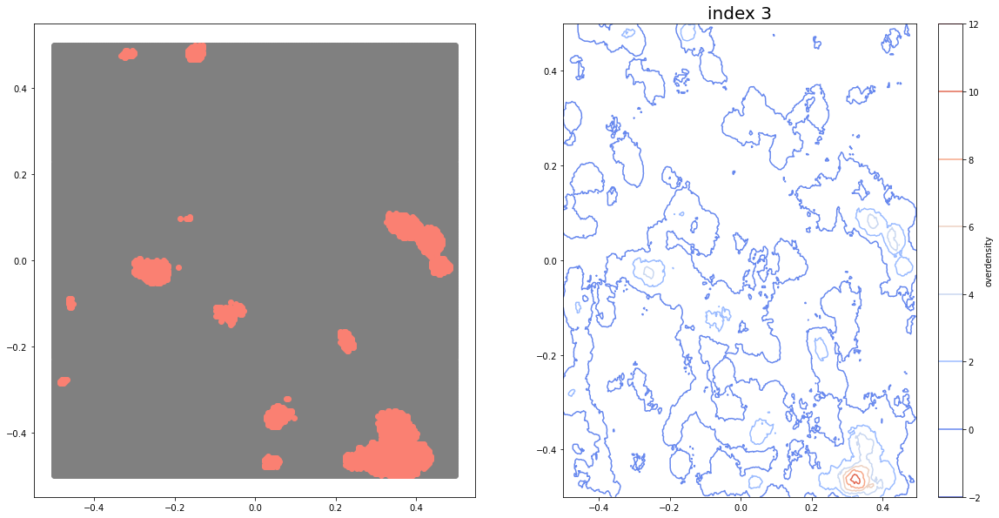

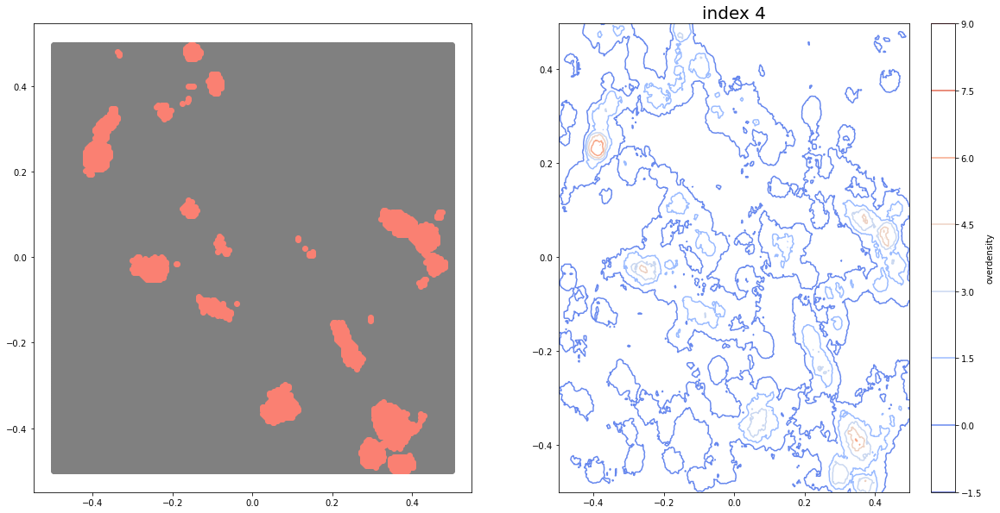

...

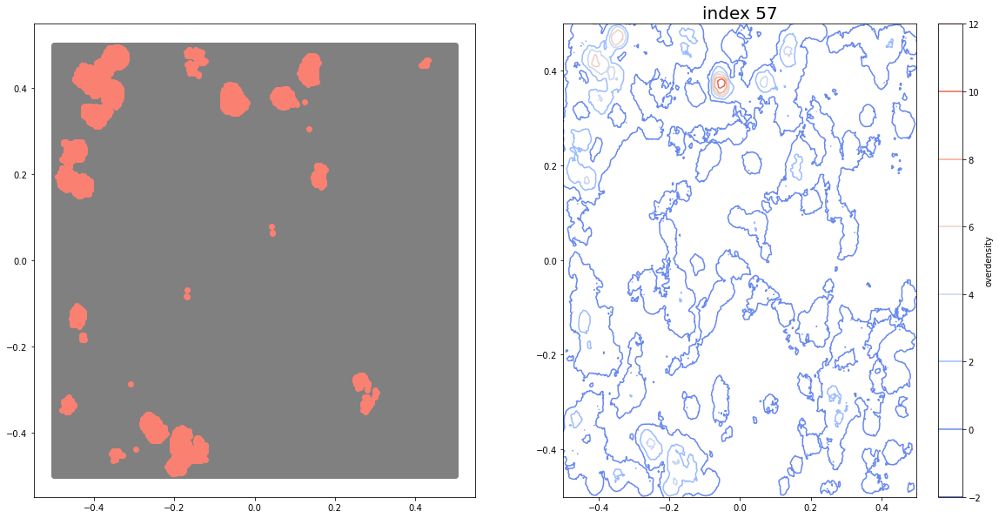

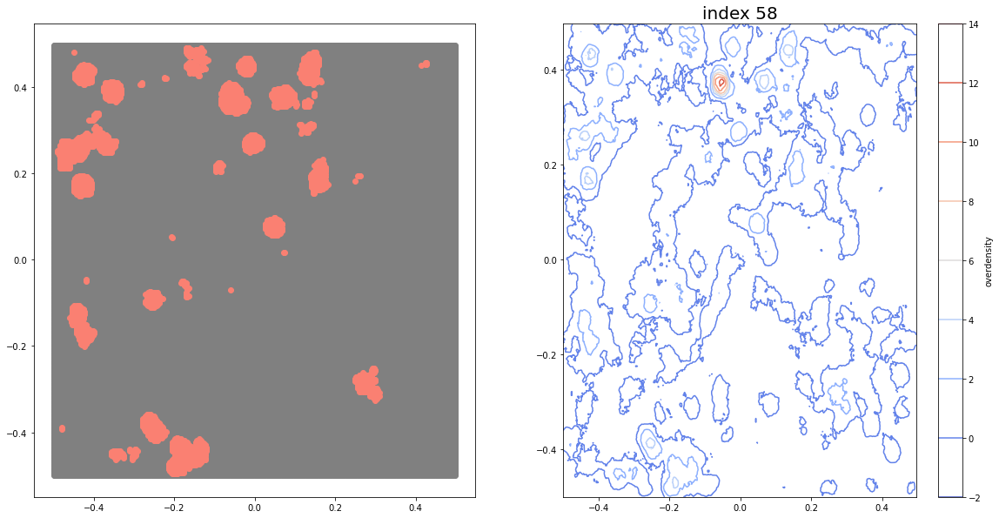

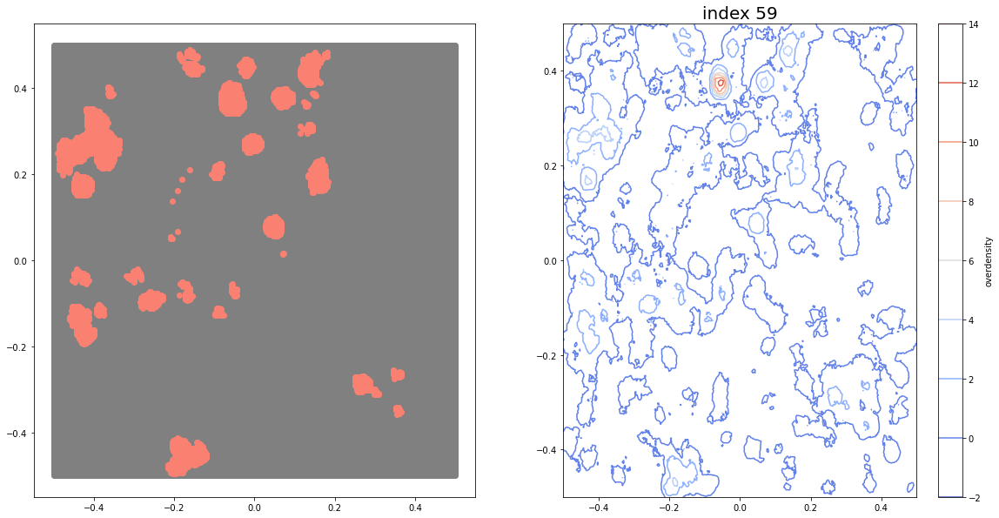

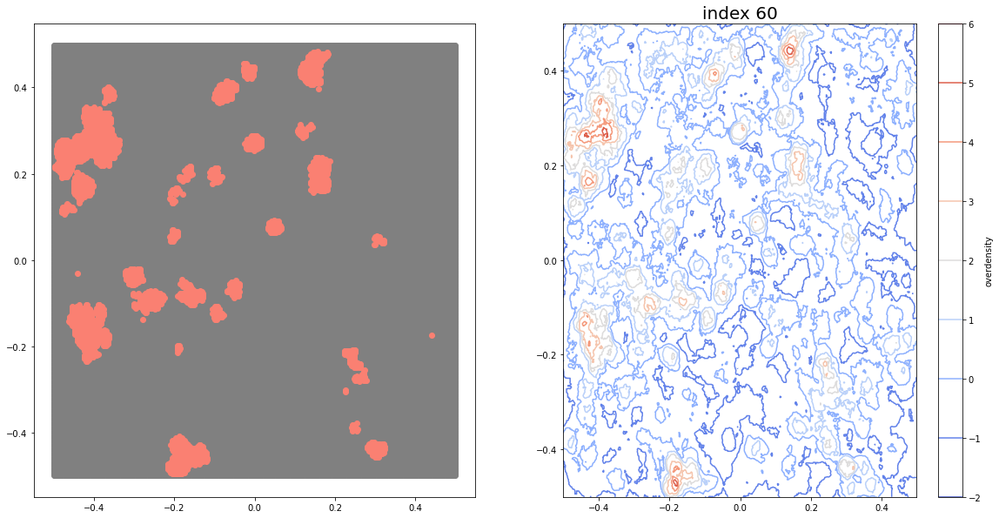

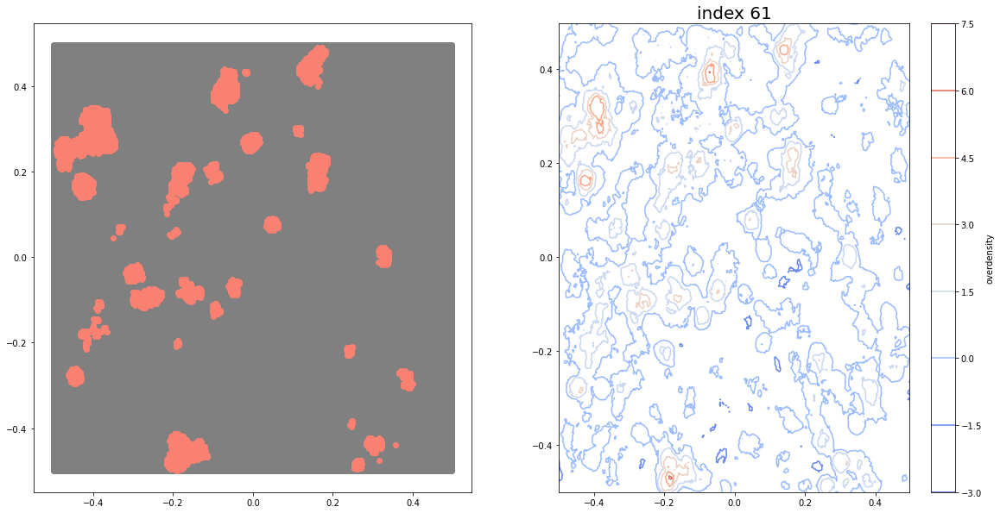

In [37]:
for i in range(len(redshifts)):

    print(i, end = ' ')

    grid = np.load('./mock/' + file_list[i])
    grid_x = np.load('./mock/grid_x/' + xlist[i])
    grid_y = np.load('./mock/grid_y/' + ylist[i])
    
    grid_1d = np.concatenate(grid)

    mean = grid_1d.mean()
    std = grid_1d.std()

    overdense_mask2 = grid > mean + 2 * std
    sparse_mask2 = grid < mean + 2 * std
    
    grid_od = (grid - mean) / std


#     area_mask = ((grid_x - ra_cl)**2 + (grid_y - dec_cl)**2 < search**2)
    
    fig, ax = plt.subplots(1, 2, figsize = (20, 10))
    ax[0].scatter(grid_x[sparse_mask2], grid_y[sparse_mask2], color = 'grey')
    ax[0].scatter(grid_x[overdense_mask2], grid_y[overdense_mask2], color = 'salmon')

    bar = ax[1].tricontour(np.concatenate(grid_x), np.concatenate(grid_y), np.concatenate(grid_od), cmap = plt.cm.coolwarm)
    plt.colorbar(bar, ax = ax[1], label = 'overdensity')


    plt.title(f'index {i}', fontsize = 20)
#     plt.savefig(f'images/clusters/densitymap/image{i}.png')



# Find overdense region

In [12]:
file_list = os.listdir(f'./mock/')
file_list.sort()

xlist = os.listdir('./mock/grid_x/')
ylist = os.listdir('./mock/grid_y/')

xlist.sort()
ylist.sort()

In [17]:
od_ra = []
od_dec = []
od_z = []


In [18]:
def overdense(od):
    od_ra = []
    od_dec = []
    od_z = []

    for i in range(len(redshifts)):
    # for i in range(1):
        od_z_ra = []
        od_z_dec = []
        od_z_z = []
        print(i, end = ' ')
        grid = np.load('./mock/' + file_list[i])

        #grid separation = 0.1Mpc
        bs = binsize[i] #binsize
        z = redshifts[i]

        gstep = find_grid_step(redshifts[i])

        grid_x = np.load('./mock/grid_x/' + xlist[i])
        grid_y = np.load('./mock/grid_y/' + ylist[i])


        grid_1d = np.concatenate(grid)
        mean = grid_1d.mean()

        std = grid_1d.std()

        overdense_mask = grid >= mean + od * std
        sparse_mask = grid < mean + od * std

        ras = grid_x[overdense_mask]
        decs = grid_y[overdense_mask]

        plt.figure()

        plt.scatter(grid_x, grid_y, color = 'grey', alpha =  .005)
        plt.scatter(ras, decs, color = 'royalblue', alpha =  .3)

        #save checked
        checked = np.full(ras.shape, True, dtype = bool)

        for k in range(len(ras)):
            #itself
            if not checked[k]:
                print('already checekd')
                continue
            else:
                print('find its first friends')

            ra = ras[k]
            dec = decs[k]
            checked[k] = False

    #         temp_checked = []

            coord_mask = ((ras - ra)**2 + (decs - dec)**2 <=  2 *gstep**2)  
            check_index = np.where(ras[coord_mask & checked])[0]

            #if it has no member
            if len(ras[coord_mask & checked]) == 0:
                print('no friends found')
                continue

            #friends
            friends_ra = ras[coord_mask & checked]
            friends_dec = decs[coord_mask & checked]
            checked[check_index] = False

            #update
            final_ra = np.concatenate([np.array([ra]), friends_ra])
            final_dec = np.concatenate([np.array([dec]), friends_dec])

            #find its friends of friends
            flag = True
            first = True

            new_ra = np.array([])
            new_dec = np.array([])
            while flag:

                if first:
                    first = False
                    cand_ra = friends_ra.copy()
                    cand_dec = friends_dec.copy()
                else:
                    cand_ra = temp_ra.copy()
                    cand_dec = temp_dec.copy()


                temp_ra = np.array([])
                temp_dec = np.array([])

                for l in range(len(cand_ra)):
                    ra2 = cand_ra[l]
                    dec2 = cand_dec[l]
                    sec_index = np.where((ras == ra2) & (decs == dec2))[0]

                    if not checked[sec_index]:
                        continue
                    else:
                        checked[sec_index] = False

                    coord_mask2 = ((ras - ra2)**2 + (decs - dec2)**2 <= 2 * gstep**2)
                    check_index2 = np.where(ras[coord_mask2 & checked])[0] 

                    if len(ras[coord_mask2 & checked])  == 0:
                        continue


                    #friends
                    temp_ra = np.concatenate([temp_ra, ras[coord_mask2 & checked]])
                    temp_dec = np.concatenate([temp_dec, decs[coord_mask2 & checked]])

                    checked[check_index2] = False

                if len(temp_ra) > 0:
                    print(f'+{len(temp_ra)}')
                    new_ra = np.concatenate([new_ra, temp_ra])
                    new_dec= np.concatenate([new_dec, temp_dec])
                else:
                    flag = False


            final_ra = np.concatenate([final_ra, new_ra])
            final_dec = np.concatenate([final_dec, new_dec])

            if len(final_ra) >= 10:        
                od_z_ra.append(final_ra)
                od_z_dec.append(final_dec)
                od_z_z.append(i)

                plt.scatter(final_ra, final_dec, color = 'firebrick', alpha = .2, s = 10)

            else:
                plt.scatter(final_ra, final_dec, color = 'yellow', alpha = .2, s = 10)
                print('less than 10 members')
#         plt.savefig(f'check/check{i}.png')
        od_ra.append(od_z_ra)
        od_dec.append(od_z_dec)
        od_z.append(od_z_z)


    return od_ra, od_dec, od_z

0 find its first friends
+7
+13
+17
+27
+31
+34
+37
+42
+44
+41
+36
+32
+32
+30
+24
+20
+19
+16
+6
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
alrea

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+14
+12
+7
+3
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
no friends found
2 find its first friends
+13
+31
+47
+58
+64
+73
+82
+86
+90
+94
+101
+107
+98
+98
+68
+42
+33
+25
+28
+35
+52
+54
+39
+34
+36
+38
+37
+30
+18
+8
+1
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
alread

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+3
+6
+8
+6
+5
+6
+4
+2
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+2
+4
+5
+5
+5
+5
+5
+5
+7
+9
+9
+9
+5
+5
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+2
+1
less than 10 members
already checekd
already checekd
already checekd
already checekd
6 find its first friends
less than 10 members
already checekd
already checekd
already checekd
find its first friends
no friends found
find its first f

already checekd
already checekd
find its first friends
+8
+3
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+9
+

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+5
+9
+13
+16
+18
+20
+21
+16
+10
+6
+2
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already c

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
13 find its first friends
+3
+6
+9
+12
+12
+11
+8
+4
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
alr

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+8
+13
+12
+15
+22
+25
+24
+23
+18
+13
+2
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already

already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
no friends found
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+4
+6
+4
+1
+1
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+9
+11
+9
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+11
+13
+23
+40
+34
+27
+41
+50
+38
+34
+30
+5
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
alr

/home/ehko/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


find its first friends
+8
+15
+16
+22
+34
+32
+31
+26
+27
+24
+9
+3
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
alre

already checekd
already checekd
already checekd
already checekd
find its first friends
no friends found
find its first friends
no friends found
find its first friends
+7
+6
+1
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+2
+1
less than 10 members
find its first friends
less than 10 members
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
no friends found
find its first friends
less than 10 members
already checekd
find its first friends
+5
+10
+25
+16
+8
+2
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already ch

no friends found
find its first friends
no friends found
find its first friends
no friends found
find its first friends
+4
+2
less than 10 members
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
no friends found
find its first friends
no friends found
find its first friends
less than 10 members
already checekd
find its first friends
no friends found
25 find its first friends
+8
+18
+22
+16
+1
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+10
+14
+20
+32
+31
+33
+41
+38
+26
+22
+18
+6
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+4
+4
+4
+5
+7
+8
+9
+12
+14
+16
+18
+19
+20
+17
+14
+13
+14
+15
+14
+14
+15
+14
+13
+11
+12
+13
+13
+4
+2
+3
+4
+3
+3
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already ch

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
less than 10 memb

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
no friends found
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd


already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+5
+7
+5
+4
+3
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
no friends found
find its first friends
+1
+1
less than 10 members
already checekd
already checekd
already checekd
find its first friends
less than 10 members
already checekd
find its fir

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
no friends found
find its first friends
less than 10 members
find its first friends
+3
+6
+1
already checekd
already checekd
already checekd
find its first friends
+8
+18
+24
+10
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checek

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+4
+6
+9
+9
+6
+2
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+1
less than 10 members
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd


already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

find its first friends
no friends found
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd


already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
54 find its first friend

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already 

already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first friends
+12
+15
+23
+37
+37
+38
+54
+62
+46
+39
+53
+53
+24
+21
+33
+22
+5
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
already checekd
find its first

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



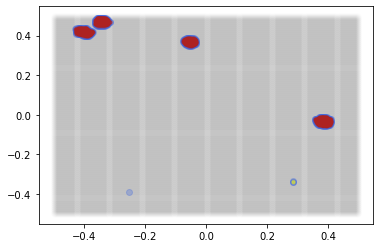

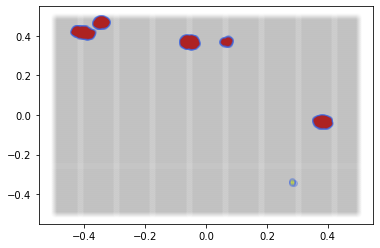

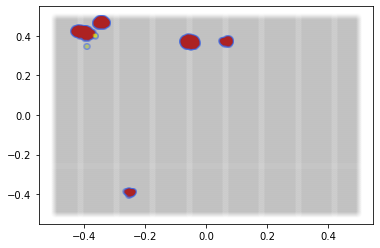

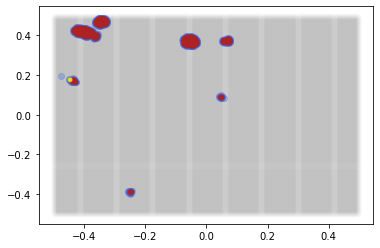

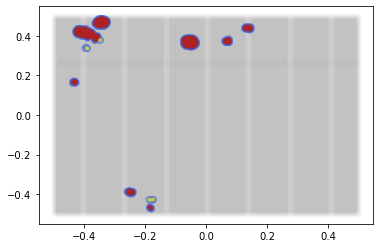

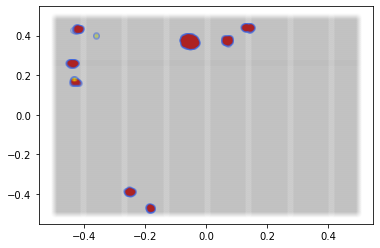

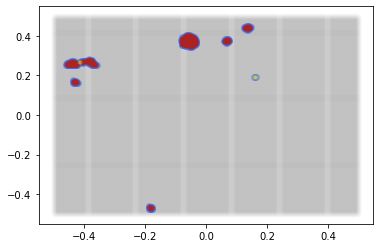

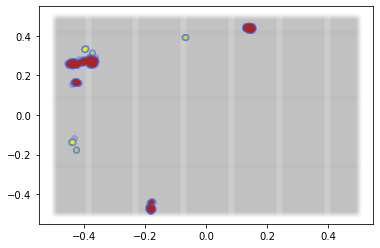

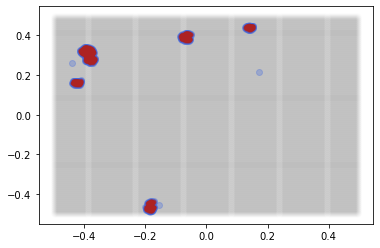

In [19]:
od = 4
od_ra, od_dec, od_z = overdense(od)

In [20]:
def find_connection(od_ra, od_dec, od_z):
    index1 = []
    index2 = []
    z_idx = []

    #just for check
    check_z = np.array([])  #check_1
    check_idx = np.array([]) # check_2

    for z in range(len(od_ra)-1):
        print(f'start {z}', end = ' ')
        for i in range(len(od_ra[z])):
            if len(od_ra[z][i]) > 9:
                print('enough connection')
            else:
                print('not enough!')
                continue

            ra_center = od_ra[z][i].mean()
            dec_center = od_dec[z][i].mean()

            zlist = []
            zlist.append(z)
            idxlist = [] #jlist
            idxlist.append(i) #jlist

            zid_list = []
            zid_list = [od_z[z][i]]

            zz = z  + 1
            print(' find its z friends')
            while True:
                if zz == len(od_ra) - 1:
                    print(' out of index')
                    break

                count = 0

                for j in range(len(od_ra[zz])):
                    ra_cand = od_ra[zz][j].mean()
                    dec_cand = od_dec[zz][j].mean()

                    if (ra_center - ra_cand)**2 + (dec_center - dec_cand)**2 < 0.001:
                        zlist.append(zz)
                        idxlist.append(j)
                        count += 1

                if count == 0:
                    print('no z friends')
                    break

                zz += 1

            if sum(np.isin(check_z, zlist) & np.isin(check_idx, idxlist)) > 0:
                print(' already counted')
            else:
                if len(zlist) > 2:
                    print(' found!')
                    index1.append(zlist)
                    index2.append(idxlist)
                    z_idx.append(zid_list)

                    check_z = np.concatenate([check_z, np.array(zlist)])
                    check_idx = np.concatenate([check_idx, np.array(idxlist)])


    return index1, index2, z_idx

In [21]:
index1, index2, z_idx = find_connection(od_ra, od_dec, od_z)

start 0 enough connection
 find its z friends
no z friends
 found!
enough connection
 find its z friends
no z friends
enough connection
 find its z friends
no z friends
enough connection
 find its z friends
no z friends
start 1 enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
start 2 enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
start 3 enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 found!
enough connection
 find its z friends
no z friends
 already counted
start 4 enough connection
 find its z friends
no z friends
enough connection
 find its z friends
no z 

no z friends
 already counted
enough connection
 find its z friends
no z friends
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
start 44 enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
enough connection
 find its z friends
no z friends
 already counted
start 45 enough connection
 find its z friends
no z friends
enough connection
 find its z friends
no z friends
enough connection
 find its z friends
no z friends
 already counted
enough connection
 find its z friends
no z friends
 already counted
enough connection

In [22]:
import seaborn as sns

/home/ehko/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


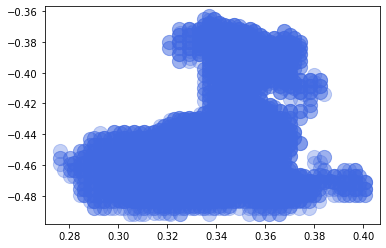

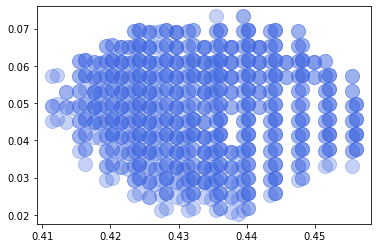

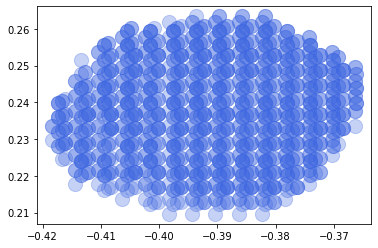

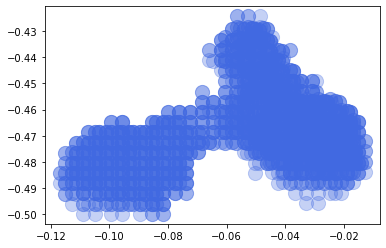

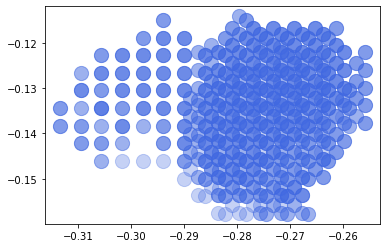

...

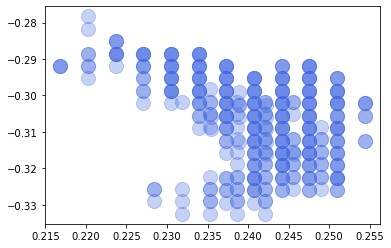

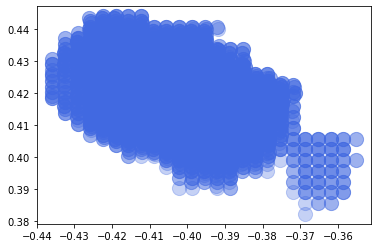

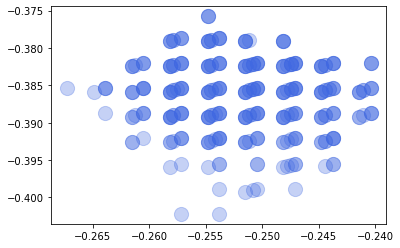

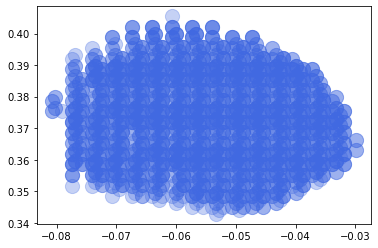

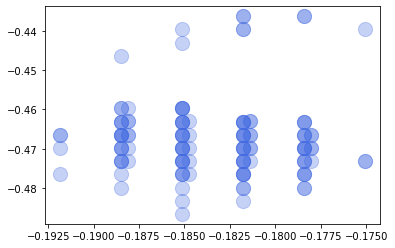

In [23]:
for i in range(len(index1)):
    
    plt.figure()
#     colors = sns.color_palette('flare',len(index1[i]))
    
    for j in range(len(index1[i])):
        plt.scatter(od_ra[index1[i][j]][index2[i][j]], od_dec[index1[i][j]][index2[i][j]], color = 'royalblue', s = 200 ,alpha = .3)
#         ra_mean = np.mean(od_ra[index1[i][j]][index2[i][j]])
#         dec_mean = np.mean(od_dec[index1[i][j]][index2[i][j]])
#         ax.scatter(ra_mean, dec_mean, color = colors[j], s = 50)
        

/home/ehko/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


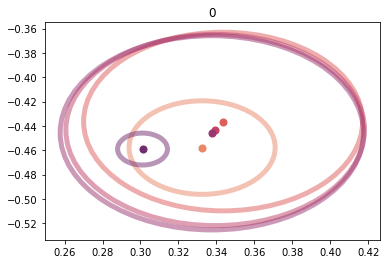

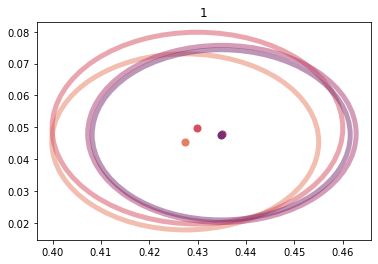

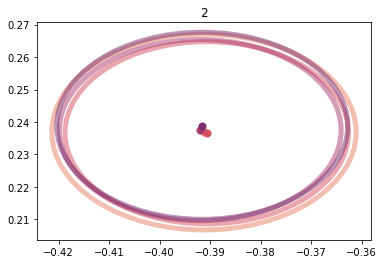

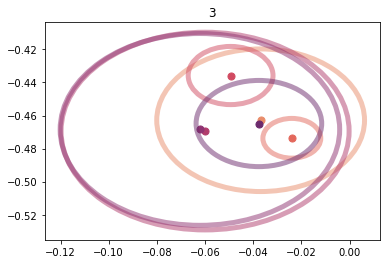

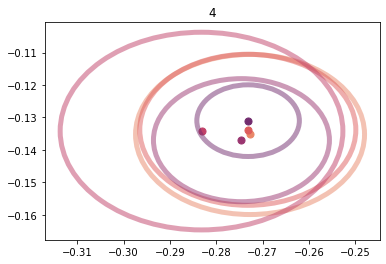

...

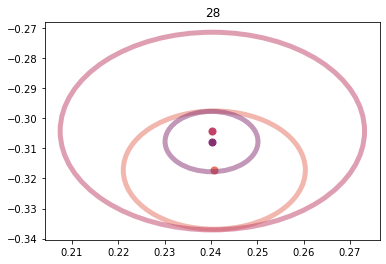

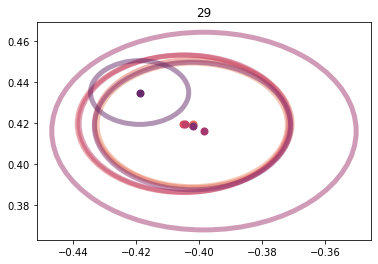

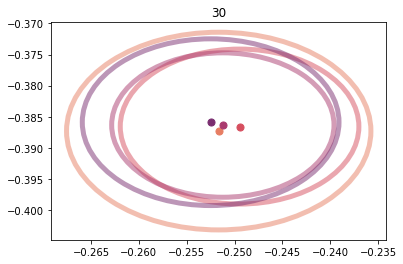

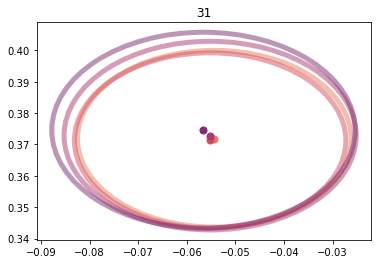

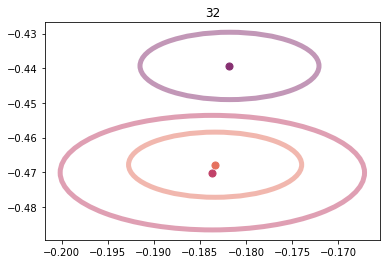

In [24]:
for i in range(len(index1)):
    
    fig, ax = plt.subplots()
    colors = sns.color_palette('flare',len(index1[i]))
    
    for j in range(len(index1[i])):
#         plt.scatter(od_ra[index1[i][j]][index2[i][j]], od_dec[index1[i][j]][index2[i][j]])
        ra_mean = np.mean(od_ra[index1[i][j]][index2[i][j]])
        dec_mean = np.mean(od_dec[index1[i][j]][index2[i][j]])
        ax.scatter(ra_mean, dec_mean, color = colors[j], s = 50)
        
        rad = (ra_mean - od_ra[index1[i][j]][index2[i][j]])**2 + (dec_mean - od_dec[index1[i][j]][index2[i][j]])**2
        rad = np.sqrt(rad)
        rad_idx = np.argmax(rad)
        
        circle = plt.Circle((ra_mean, dec_mean), rad[rad_idx], fill = False, color = colors[j], lw = 5, alpha = .5)
        ax.add_patch(circle)
    ax.set_title(f'{i}')
    

In [26]:
#save index of overdense region
with open(f'./mock/ods/index1_od{od}.txt', 'wb') as f:
    pickle.dump(index1, f)

with open(f'./mock/ods/index2_od{od}.txt', 'wb') as f:
    pickle.dump(index2, f)

with open(f'./mock/ods/od{od}_ra.txt', 'wb') as f:
    pickle.dump(od_ra, f)
    
with open(f'./mock/ods/od{od}_dec.txt', 'wb') as f:
    pickle.dump(od_dec, f)
    
with open(f'./mock/ods/z_idx_od{od}.txt', 'wb') as f:
    pickle.dump(z_idx, f)

# Find overdense region

In [13]:
#save index of overdense region
od = 4
with open(f'./mock/ods/index1_od{od}.txt', 'rb') as f:
    index1 = pickle.load(f)

with open(f'./mock/ods/index2_od{od}.txt', 'rb') as f:
    index2 = pickle.load(f)

with open(f'./mock/ods/od{od}_ra.txt', 'rb') as f:
    od_ra = pickle.load(f)
    
with open(f'./mock/ods/od{od}_dec.txt', 'rb') as f:
    od_dec = pickle.load(f)
    
with open(f'./mock/ods/z_idx_od{od}.txt', 'rb') as f:
    z_idx = pickle.load(f)
    

In [14]:

def find_radius(z, r):
    r = cosmo.arcsec_per_kpc_proper(z) * r * u.Mpc # arcsec
    
    return r.to(u.deg).value

In [15]:
all_mems = []
ra_cls = []
dec_cls = []
z_cls = []

for i in range(len(index1)): 
    print(i, end = ' ')
    final_mems = []
    final_ras = []
    final_decs = []
    final_zs = []
    
    for j in range(len(index1[i])):
        print(j)
        z_mems = []
        z_ras = []
        z_decs = []
        z_zs = []
        for k in range(len(od_ra[index1[i][j]][index2[i][j]])):
            ra = od_ra[index1[i][j]][index2[i][j]][k]
            dec = od_dec[index1[i][j]][index2[i][j]][k]
            
            
            zz = redshifts[index1[i][j]]
            
            search = find_radius(zz, 0.1)
            mem_mask = (data['RA_true'] - ra)**2 + (data['DEC_true'] - dec)**2 < search**2
            mem_mask2 = (data['z_true'] > zz - 0.015 * (1+zz)) & (data['z_true'] < zz + 0.015 * (1+zz))
            mems = data[mem_mask & mem_mask2]
            
            z_mems.append(mems['ID'].tolist())
            z_ras.append(mems['RA_true'].tolist())
            z_decs.append(mems['DEC_true'].tolist())
            z_zs.append(mems['z_true'].tolist())
            
            
        final_mems.append(np.concatenate(z_mems))
        final_ras.append(np.concatenate(z_ras))
        final_decs.append(np.concatenate(z_decs))
        final_zs.append(np.concatenate(z_zs))
    all_mems.append(final_mems)
    ra_cls.append(final_ras)
    dec_cls.append(final_decs)
    z_cls.append(final_zs)
            
#         ra_mean = np.mean(od_ra[index1[i][j]][index2[i][j]])
#         dec_mean = np.mean(od_dec[index1[i][j]][index2[i][j]])
        

0 0
1


KeyboardInterrupt: 

In [30]:
cand_ra = []
cand_dec = []
cand_z = []

for i in range(len(ra_cls)):

    
    ra_mean = np.mean(np.concatenate(ra_cls[i]))
    dec_mean = np.mean(np.concatenate(dec_cls[i]))
    
    z_means = np.concatenate(z_cls[i])
#     zmask = (z_means > 0) & (z_means < 9)
#     z_means = z_means[zmask]
    
    z_mean = np.mean(z_means)
    
    cand_ra.append(ra_mean)
    cand_dec.append(dec_mean)
    cand_z.append(z_mean)

In [31]:
# plt.scatter(cand_ra, cand_dec)
final_members = []
final_ras = []
final_decs = []
final_zs = []

for i in range(len(cand_ra)):
    
    z = cand_z[i]
    
    search = find_radius(z, 1)
    mmask = (data['RA_true'] - cand_ra[i])**2 + (data['DEC_true'] - cand_dec[i])**2 < search**2
    mmask2 = (data['z_true'] > z - 0.015 * (1+z)) & (data['z_true'] <  z + 0.015 * (1+z))
    members = data[mmask & mmask2]
    
    ra = sum(members['MASS_true'] * members['RA_true']) / sum(members['MASS_true'])
    dec = sum(members['MASS_true'] * members['DEC_true']) / sum(members['MASS_true'])
    zz = sum(members['MASS_true'] * members['z_true']) / sum(members['MASS_true'])
    
    final_ras.append(ra)
    final_decs.append(dec)
    final_zs.append(zz)
    
    fmask1 = (data['RA_true'] - ra)**2 + (data['DEC_true'] - dec)**2 < search**2
    fmask2 = (data['z_true'] > zz - 0.015 * (1+zz)) & (data['z_true'] <  zz + 0.015 * (1+zz))
    fmems = data[fmask1 & fmask2]
    
    final_members.append(fmems['ID'].tolist())

In [32]:
# data.keys()

In [33]:
#save index of overdense region
with open(f'./mock/ods/final_ras.txt', 'wb') as f:
    pickle.dump(final_ras, f)

with open(f'./mock/ods/final_decs.txt', 'wb') as f:
    pickle.dump(final_decs, f)

with open(f'./mock/ods/final_zs.txt', 'wb') as f:
    pickle.dump(final_zs, f)
    
with open(f'./mock/ods/final_members.txt', 'wb') as f:
    pickle.dump(final_members, f)


In [34]:
len(final_members)
num_mems = [len(x) for x in final_members]
# num_mems

# density map


In [22]:

def find_radius(z, r):
    r = cosmo.arcsec_per_kpc_proper(z) * r * u.Mpc # arcsec
    
    return r.to(u.deg).value

In [16]:
file_list = os.listdir(f'./mock/')
file_list.sort()

xlist = os.listdir('./mock/grid_x/')
ylist = os.listdir('./mock/grid_y/')

xlist.sort()
ylist.sort()

In [17]:
#save index of overdense region
with open(f'./mock/ods/final_ras.txt', 'rb') as f:
    final_ras = pickle.load(f)

with open(f'./mock/ods/final_decs.txt', 'rb') as f:
    final_decs = pickle.load(f)

with open(f'./mock/ods/final_zs.txt', 'rb') as f:
    final_zs = pickle.load(f)
    
with open(f'./mock/ods/final_members.txt', 'rb') as f:
    final_members = pickle.load(f)


In [18]:
def find_fofs(cra, cdec, fof_ra, fof_dec, z_index, ll):
    
    check = np.full(fof_ra.shape, True, dtype = bool) #index
    print(f'total {len(fof_ra)} grid points')
    #2Mpc
    gstep = find_radius(redshifts[z_index], ll)

    f1mask = (cra - fof_ra)**2 + (cdec - fof_dec)**2 <= gstep**2
    f1_index = list(np.where(f1mask)[0])
    
    check[f1mask] = False
    
    if len(f1_index) == 0:
        print('no first friend found')
        return 
    
    new_index = []
    
    temp_index = []
    
    first = True
    while True:
        if first:
            first = False
            cand_index = f1_index.copy()
        else:
            cand_index = temp_index.copy()
            temp_index = []
            
#         print(len(cand_index))
#         print(cand_index)
        for j in range(len(cand_index)):
            f2mask = (fof_ra[cand_index[j]] - fof_ra)**2 + (fof_dec[cand_index[j]] - fof_dec)**2 < gstep**2
            f2_index = np.where(f2mask & check)[0]
            
            check[f2_index] = False
            
            if len(f2_index)  == 0:
                continue
                
            temp_index.extend(list(f2_index))
        new_index.extend(temp_index)
        if len(temp_index) == 0:
            break
#     print(new_index)
    f1_index.extend(new_index)
    final_index = f1_index
    return final_index

In [19]:
data_pd = data.to_pandas()

In [20]:
final_zs[10]

0.7853495757953574

total 1484 grid points
total 888 grid points
total 1260 grid points
total 1624 grid points
total 2365 grid points
total 2268 grid points
total 938 grid points
total 599 grid points
total 1313 grid points
total 1967 grid points
total 2252 grid points
total 2109 grid points
total 1726 grid points
total 1077 grid points
total 1350 grid points
total 1664 grid points
total 1338 grid points
total 1294 grid points
total 2078 grid points
total 1280 grid points
total 689 grid points


/home/ehko/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


total 1464 grid points
total 425 grid points


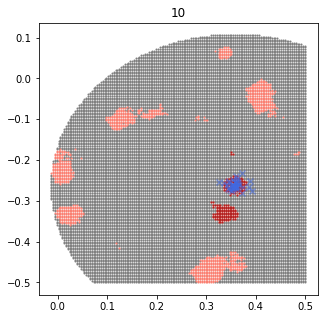

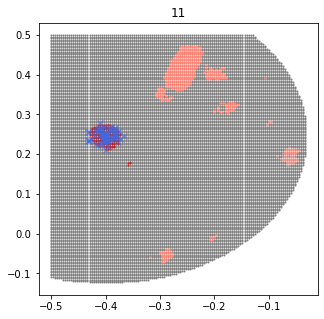

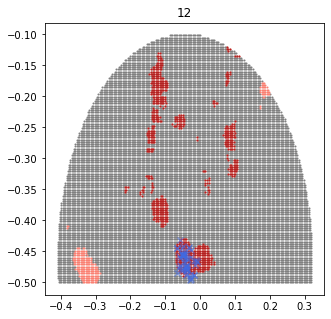

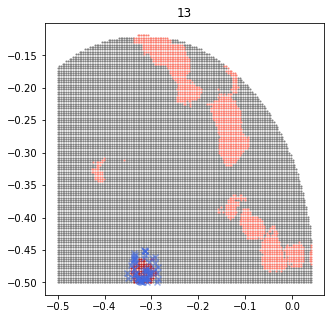

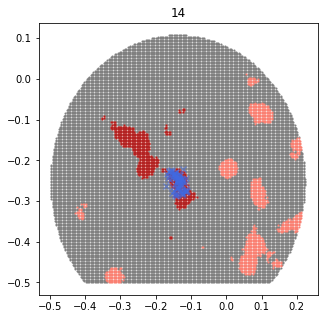

...

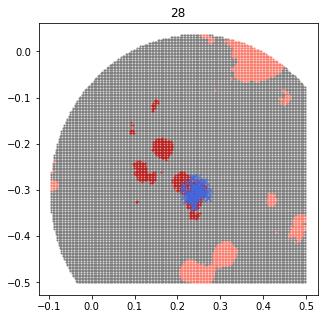

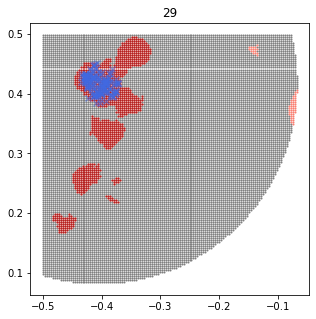

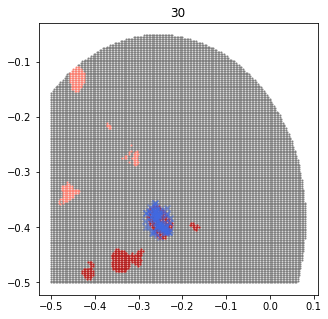

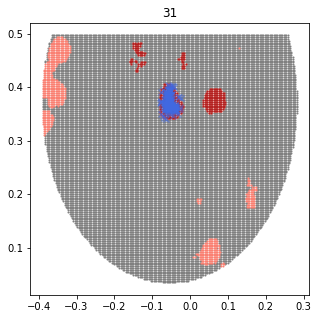

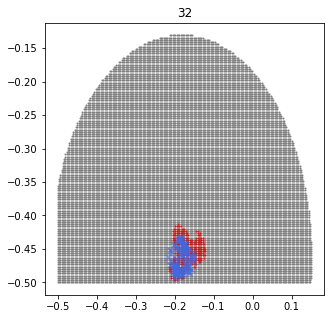

In [23]:
fofs = []
fqs = []

for i in range(10,len(final_members)):
    z_index = np.argmin((redshifts - final_zs[i])**2) 
    grid = np.load('./mock/' + file_list[z_index])

    grid_x = np.load('./mock/grid_x/' + xlist[z_index])
    grid_y = np.load('./mock/grid_y/' + ylist[z_index])

    grid_1d = np.concatenate(grid)

    mean = grid_1d.mean()
    std = grid_1d.std()

    overdense_mask2 = grid > mean + 2 * std
    sparse_mask2 = grid < mean + 2 * std

    grid_od = (grid - mean) / std

    search = find_radius(final_zs[i], 10)
    area_mask = ((grid_x - final_ras[i])**2 + (grid_y - final_decs[i])**2 < search**2)

    
    mmask = data_pd['ID'].isin(final_members[i])
    mems = data_pd[mmask]
    
    findex = find_fofs(np.mean(mems['RA_true']), np.mean(mems['DEC_true']), grid_x[area_mask&overdense_mask2], grid_y[area_mask&overdense_mask2], z_index, 2)    

    fof = len(grid_x[area_mask & overdense_mask2][findex]) / len(grid_x[area_mask])
    fofs.append(fof)
    
    age = cosmo.age(np.mean(mems['z_true'])).to(u.yr).value
    ssfr = mems['SFR_true']/10**mems['MASS_true']+1e-12
#     ssfr_mask  = mems['SFR_true'] / 10**mems['MASS_true'] < 1 / 3 / age
    ssfr_mask  = ssfr < 1 / 3 / age
    
    ssfr = mems[ssfr_mask]
    
    fq2 = len(ssfr) / len(mems)
    fqs.append(fq2)
    
    fig, ax = plt.subplots(figsize = (5, 5))
    ax.scatter(grid_x[area_mask&sparse_mask2], grid_y[ area_mask& sparse_mask2], color = 'grey', s = 1)
    ax.scatter(grid_x[ area_mask&overdense_mask2], grid_y[area_mask& overdense_mask2], color = 'salmon', s = 1)
    
    ax.set_title(f'{i}')
    
    ax.scatter(grid_x[ area_mask & overdense_mask2][findex], grid_y[area_mask & overdense_mask2][findex], color = 'firebrick', alpha = 1, s = 1)

    ax.scatter(mems['RA_true'], mems['DEC_true'], color = 'royalblue', marker = 'x', alpha = .5)
 
    

0.06379643489755947


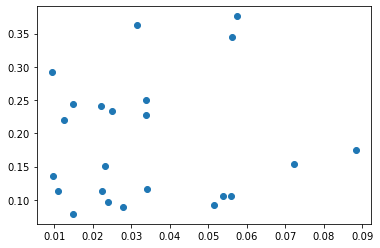

In [32]:
plt.scatter(fofs, fqs)
print(np.corrcoef(fofs, fqs)[0, 1])

In [33]:
fofss = []

for ss in np.arange(0.3, 3.1, 0.1):
    fofsss = []
    
    for i in range(10,len(final_members)):
        z_index = np.argmin((redshifts - final_zs[i])**2) 
        grid = np.load('./mock/' + file_list[z_index])

        grid_x = np.load('./mock/grid_x/' + xlist[z_index])
        grid_y = np.load('./mock/grid_y/' + ylist[z_index])

        grid_1d = np.concatenate(grid)

        mean = grid_1d.mean()
        std = grid_1d.std()

        overdense_mask2 = grid > mean + 2 * std
        sparse_mask2 = grid < mean + 2 * std

        grid_od = (grid - mean) / std

        search = find_radius(final_zs[i], 10)
        area_mask = ((grid_x - final_ras[i])**2 + (grid_y - final_decs[i])**2 < search**2)


        mmask = data_pd['ID'].isin(final_members[i])
        mems = data_pd[mmask]

        findex = find_fofs(np.mean(mems['RA_true']), np.mean(mems['DEC_true']), grid_x[area_mask&overdense_mask2], grid_y[area_mask&overdense_mask2], z_index, ss)    

        fof = len(grid_x[area_mask & overdense_mask2][findex]) / len(grid_x[area_mask])
        fofsss.append(fof)
    fofss.append(fofsss)





total 1484 grid points
total 888 grid points
total 1260 grid points
total 1624 grid points
total 2365 grid points
total 2268 grid points
total 938 grid points
total 599 grid points
total 1313 grid points
total 1967 grid points
total 2252 grid points
total 2109 grid points
total 1726 grid points
total 1077 grid points
total 1350 grid points
total 1664 grid points
total 1338 grid points
total 1294 grid points
total 2078 grid points
total 1280 grid points
total 689 grid points
total 1464 grid points
total 425 grid points
total 1484 grid points
total 888 grid points
total 1260 grid points
total 1624 grid points
total 2365 grid points
total 2268 grid points
total 938 grid points
total 599 grid points
total 1313 grid points
total 1967 grid points
total 2252 grid points
total 2109 grid points
total 1726 grid points
total 1077 grid points
total 1350 grid points
total 1664 grid points
total 1338 grid points
total 1294 grid points
total 2078 grid points
total 1280 grid points
total 689 grid poin

In [25]:
def cal_fof(radius):

    fofss = []
    for ss in np.arange(0.3, 3.1, 0.1):
        fofsss = []

        for i in range(10,len(final_members)):
            z_index = np.argmin((redshifts - final_zs[i])**2) 
            grid = np.load('./mock/' + file_list[z_index])

            grid_x = np.load('./mock/grid_x/' + xlist[z_index])
            grid_y = np.load('./mock/grid_y/' + ylist[z_index])

            grid_1d = np.concatenate(grid)

            mean = grid_1d.mean()
            std = grid_1d.std()

            overdense_mask2 = grid > mean + 2 * std
            sparse_mask2 = grid < mean + 2 * std

            grid_od = (grid - mean) / std

            search = find_radius(final_zs[i], radius)
            area_mask = ((grid_x - final_ras[i])**2 + (grid_y - final_decs[i])**2 < search**2)


            mmask = data_pd['ID'].isin(final_members[i])
            mems = data_pd[mmask]

            findex = find_fofs(np.mean(mems['RA_true']), np.mean(mems['DEC_true']), grid_x[area_mask&overdense_mask2], grid_y[area_mask&overdense_mask2], z_index, ss)    

            fof = len(grid_x[area_mask & overdense_mask2][findex]) / len(grid_x[area_mask])
            fofsss.append(fof)
        fofss.append(fofsss)
    return fofss


In [46]:
total_fofs = []
for i in np.arange(3, 15.5, 0.5):
    total = cal_fof(i)
    total_fofs.append(total)

total 251 grid points
total 204 grid points
total 410 grid points
total 126 grid points
total 484 grid points
total 361 grid points
total 293 grid points
total 597 grid points
total 424 grid points
total 288 grid points
total 687 grid points
total 472 grid points
total 388 grid points
total 463 grid points
total 419 grid points
total 405 grid points
total 466 grid points
total 528 grid points
total 374 grid points
total 934 grid points
total 289 grid points
total 338 grid points
total 425 grid points
total 251 grid points
total 204 grid points
total 410 grid points
total 126 grid points
total 484 grid points
total 361 grid points
total 293 grid points
total 597 grid points
total 424 grid points
total 288 grid points
total 687 grid points
total 472 grid points
total 388 grid points
total 463 grid points
total 419 grid points
total 405 grid points
total 466 grid points
total 528 grid points
total 374 grid points
total 934 grid points
total 289 grid points
total 338 grid points
total 425 

total 484 grid points
total 361 grid points
total 293 grid points
total 597 grid points
total 424 grid points
total 288 grid points
total 687 grid points
total 472 grid points
total 388 grid points
total 463 grid points
total 419 grid points
total 405 grid points
total 466 grid points
total 528 grid points
total 374 grid points
total 934 grid points
total 289 grid points
total 338 grid points
total 425 grid points
total 251 grid points
total 204 grid points
total 410 grid points
total 126 grid points
total 484 grid points
total 361 grid points
total 293 grid points
total 597 grid points
total 424 grid points
total 288 grid points
total 687 grid points
total 472 grid points
total 388 grid points
total 463 grid points
total 419 grid points
total 405 grid points
total 466 grid points
total 528 grid points
total 374 grid points
total 934 grid points
total 289 grid points
total 338 grid points
total 425 grid points
total 251 grid points
total 204 grid points
total 410 grid points
total 126 

total 433 grid points
total 341 grid points
total 867 grid points
total 638 grid points
total 422 grid points
total 555 grid points
total 454 grid points
total 407 grid points
total 537 grid points
total 542 grid points
total 456 grid points
total 962 grid points
total 359 grid points
total 426 grid points
total 425 grid points
total 251 grid points
total 204 grid points
total 465 grid points
total 126 grid points
total 586 grid points
total 370 grid points
total 303 grid points
total 597 grid points
total 433 grid points
total 341 grid points
total 867 grid points
total 638 grid points
total 422 grid points
total 555 grid points
total 454 grid points
total 407 grid points
total 537 grid points
total 542 grid points
total 456 grid points
total 962 grid points
total 359 grid points
total 426 grid points
total 425 grid points
total 251 grid points
total 204 grid points
total 465 grid points
total 126 grid points
total 586 grid points
total 370 grid points
total 303 grid points
total 597 

total 422 grid points
total 555 grid points
total 454 grid points
total 407 grid points
total 537 grid points
total 542 grid points
total 456 grid points
total 962 grid points
total 359 grid points
total 426 grid points
total 425 grid points
total 251 grid points
total 204 grid points
total 465 grid points
total 126 grid points
total 586 grid points
total 370 grid points
total 303 grid points
total 597 grid points
total 433 grid points
total 341 grid points
total 867 grid points
total 638 grid points
total 422 grid points
total 555 grid points
total 454 grid points
total 407 grid points
total 537 grid points
total 542 grid points
total 456 grid points
total 962 grid points
total 359 grid points
total 426 grid points
total 425 grid points
total 251 grid points
total 204 grid points
total 465 grid points
total 126 grid points
total 586 grid points
total 370 grid points
total 303 grid points
total 597 grid points
total 433 grid points
total 341 grid points
total 867 grid points
total 638 

total 597 grid points
total 577 grid points
total 605 grid points
total 962 grid points
total 431 grid points
total 523 grid points
total 425 grid points
total 253 grid points
total 226 grid points
total 481 grid points
total 126 grid points
total 725 grid points
total 429 grid points
total 303 grid points
total 597 grid points
total 475 grid points
total 382 grid points
total 951 grid points
total 756 grid points
total 422 grid points
total 680 grid points
total 465 grid points
total 435 grid points
total 597 grid points
total 577 grid points
total 605 grid points
total 962 grid points
total 431 grid points
total 523 grid points
total 425 grid points
total 253 grid points
total 226 grid points
total 481 grid points
total 126 grid points
total 725 grid points
total 429 grid points
total 303 grid points
total 597 grid points
total 475 grid points
total 382 grid points
total 951 grid points
total 756 grid points
total 422 grid points
total 680 grid points
total 465 grid points
total 435 

total 431 grid points
total 523 grid points
total 425 grid points
total 253 grid points
total 226 grid points
total 481 grid points
total 126 grid points
total 725 grid points
total 429 grid points
total 303 grid points
total 597 grid points
total 475 grid points
total 382 grid points
total 951 grid points
total 756 grid points
total 422 grid points
total 680 grid points
total 465 grid points
total 435 grid points
total 597 grid points
total 577 grid points
total 605 grid points
total 962 grid points
total 431 grid points
total 523 grid points
total 425 grid points
total 253 grid points
total 226 grid points
total 481 grid points
total 126 grid points
total 725 grid points
total 429 grid points
total 303 grid points
total 597 grid points
total 475 grid points
total 382 grid points
total 951 grid points
total 756 grid points
total 422 grid points
total 680 grid points
total 465 grid points
total 435 grid points
total 597 grid points
total 577 grid points
total 605 grid points
total 962 

total 264 grid points
total 244 grid points
total 495 grid points
total 127 grid points
total 860 grid points
total 551 grid points
total 303 grid points
total 597 grid points
total 498 grid points
total 470 grid points
total 958 grid points
total 825 grid points
total 422 grid points
total 767 grid points
total 465 grid points
total 505 grid points
total 687 grid points
total 628 grid points
total 775 grid points
total 1007 grid points
total 441 grid points
total 575 grid points
total 425 grid points
total 264 grid points
total 244 grid points
total 495 grid points
total 127 grid points
total 860 grid points
total 551 grid points
total 303 grid points
total 597 grid points
total 498 grid points
total 470 grid points
total 958 grid points
total 825 grid points
total 422 grid points
total 767 grid points
total 465 grid points
total 505 grid points
total 687 grid points
total 628 grid points
total 775 grid points
total 1007 grid points
total 441 grid points
total 575 grid points
total 42

total 150 grid points
total 956 grid points
total 690 grid points
total 303 grid points
total 597 grid points
total 498 grid points
total 586 grid points
total 987 grid points
total 875 grid points
total 422 grid points
total 781 grid points
total 467 grid points
total 589 grid points
total 818 grid points
total 686 grid points
total 966 grid points
total 1085 grid points
total 441 grid points
total 575 grid points
total 425 grid points
total 326 grid points
total 289 grid points
total 509 grid points
total 150 grid points
total 956 grid points
total 690 grid points
total 303 grid points
total 597 grid points
total 498 grid points
total 586 grid points
total 987 grid points
total 875 grid points
total 422 grid points
total 781 grid points
total 467 grid points
total 589 grid points
total 818 grid points
total 686 grid points
total 966 grid points
total 1085 grid points
total 441 grid points
total 575 grid points
total 425 grid points
total 326 grid points
total 289 grid points
total 50

total 303 grid points
total 597 grid points
total 498 grid points
total 586 grid points
total 987 grid points
total 875 grid points
total 422 grid points
total 781 grid points
total 467 grid points
total 589 grid points
total 818 grid points
total 686 grid points
total 966 grid points
total 1085 grid points
total 441 grid points
total 575 grid points
total 425 grid points
total 326 grid points
total 289 grid points
total 509 grid points
total 150 grid points
total 956 grid points
total 690 grid points
total 303 grid points
total 597 grid points
total 498 grid points
total 586 grid points
total 987 grid points
total 875 grid points
total 422 grid points
total 781 grid points
total 467 grid points
total 589 grid points
total 818 grid points
total 686 grid points
total 966 grid points
total 1085 grid points
total 441 grid points
total 575 grid points
total 425 grid points
total 326 grid points
total 289 grid points
total 509 grid points
total 150 grid points
total 956 grid points
total 69

total 535 grid points
total 627 grid points
total 1094 grid points
total 957 grid points
total 422 grid points
total 781 grid points
total 514 grid points
total 676 grid points
total 956 grid points
total 776 grid points
total 1138 grid points
total 1125 grid points
total 464 grid points
total 575 grid points
total 425 grid points
total 488 grid points
total 362 grid points
total 529 grid points
total 177 grid points
total 1023 grid points
total 817 grid points
total 303 grid points
total 597 grid points
total 535 grid points
total 627 grid points
total 1094 grid points
total 957 grid points
total 422 grid points
total 781 grid points
total 514 grid points
total 676 grid points
total 956 grid points
total 776 grid points
total 1138 grid points
total 1125 grid points
total 464 grid points
total 575 grid points
total 425 grid points
total 488 grid points
total 362 grid points
total 529 grid points
total 177 grid points
total 1023 grid points
total 817 grid points
total 303 grid points
to

total 627 grid points
total 1094 grid points
total 957 grid points
total 422 grid points
total 781 grid points
total 514 grid points
total 676 grid points
total 956 grid points
total 776 grid points
total 1138 grid points
total 1125 grid points
total 464 grid points
total 575 grid points
total 425 grid points
total 488 grid points
total 362 grid points
total 529 grid points
total 177 grid points
total 1023 grid points
total 817 grid points
total 303 grid points
total 597 grid points
total 535 grid points
total 627 grid points
total 1094 grid points
total 957 grid points
total 422 grid points
total 781 grid points
total 514 grid points
total 676 grid points
total 956 grid points
total 776 grid points
total 1138 grid points
total 1125 grid points
total 464 grid points
total 575 grid points
total 425 grid points
total 488 grid points
total 362 grid points
total 529 grid points
total 177 grid points
total 1023 grid points
total 817 grid points
total 303 grid points
total 597 grid points
to

total 701 grid points
total 1295 grid points
total 1082 grid points
total 522 grid points
total 793 grid points
total 581 grid points
total 750 grid points
total 1046 grid points
total 862 grid points
total 1209 grid points
total 1141 grid points
total 505 grid points
total 582 grid points
total 425 grid points
total 652 grid points
total 445 grid points
total 594 grid points
total 213 grid points
total 1101 grid points
total 900 grid points
total 319 grid points
total 597 grid points
total 656 grid points
total 701 grid points
total 1295 grid points
total 1082 grid points
total 522 grid points
total 793 grid points
total 581 grid points
total 750 grid points
total 1046 grid points
total 862 grid points
total 1209 grid points
total 1141 grid points
total 505 grid points
total 582 grid points
total 425 grid points
total 652 grid points
total 445 grid points
total 594 grid points
total 213 grid points
total 1101 grid points
total 900 grid points
total 319 grid points
total 597 grid point

total 701 grid points
total 1295 grid points
total 1082 grid points
total 522 grid points
total 793 grid points
total 581 grid points
total 750 grid points
total 1046 grid points
total 862 grid points
total 1209 grid points
total 1141 grid points
total 505 grid points
total 582 grid points
total 425 grid points
total 652 grid points
total 445 grid points
total 594 grid points
total 213 grid points
total 1101 grid points
total 900 grid points
total 319 grid points
total 597 grid points
total 656 grid points
total 701 grid points
total 1295 grid points
total 1082 grid points
total 522 grid points
total 793 grid points
total 581 grid points
total 750 grid points
total 1046 grid points
total 862 grid points
total 1209 grid points
total 1141 grid points
total 505 grid points
total 582 grid points
total 425 grid points
total 652 grid points
total 445 grid points
total 594 grid points
total 213 grid points
total 1101 grid points
total 900 grid points
total 319 grid points
total 597 grid point

total 807 grid points
total 836 grid points
total 1566 grid points
total 1254 grid points
total 768 grid points
total 830 grid points
total 675 grid points
total 834 grid points
total 1048 grid points
total 909 grid points
total 1232 grid points
total 1141 grid points
total 557 grid points
total 585 grid points
total 425 grid points
total 822 grid points
total 545 grid points
total 704 grid points
total 277 grid points
total 1210 grid points
total 1099 grid points
total 394 grid points
total 597 grid points
total 807 grid points
total 836 grid points
total 1566 grid points
total 1254 grid points
total 768 grid points
total 830 grid points
total 675 grid points
total 834 grid points
total 1048 grid points
total 909 grid points
total 1232 grid points
total 1141 grid points
total 557 grid points
total 585 grid points
total 425 grid points
total 822 grid points
total 545 grid points
total 704 grid points
total 277 grid points
total 1210 grid points
total 1099 grid points
total 394 grid poi

total 597 grid points
total 920 grid points
total 990 grid points
total 1813 grid points
total 1429 grid points
total 1064 grid points
total 880 grid points
total 793 grid points
total 919 grid points
total 1071 grid points
total 980 grid points
total 1249 grid points
total 1164 grid points
total 581 grid points
total 585 grid points
total 425 grid points
total 925 grid points
total 674 grid points
total 783 grid points
total 377 grid points
total 1335 grid points
total 1387 grid points
total 573 grid points
total 597 grid points
total 920 grid points
total 990 grid points
total 1813 grid points
total 1429 grid points
total 1064 grid points
total 880 grid points
total 793 grid points
total 919 grid points
total 1071 grid points
total 980 grid points
total 1249 grid points
total 1164 grid points
total 581 grid points
total 585 grid points
total 425 grid points
total 925 grid points
total 674 grid points
total 783 grid points
total 377 grid points
total 1335 grid points
total 1387 grid p

total 1387 grid points
total 573 grid points
total 597 grid points
total 920 grid points
total 990 grid points
total 1813 grid points
total 1429 grid points
total 1064 grid points
total 880 grid points
total 793 grid points
total 919 grid points
total 1071 grid points
total 980 grid points
total 1249 grid points
total 1164 grid points
total 581 grid points
total 585 grid points
total 425 grid points
total 925 grid points
total 674 grid points
total 783 grid points
total 377 grid points
total 1335 grid points
total 1387 grid points
total 573 grid points
total 597 grid points
total 920 grid points
total 990 grid points
total 1813 grid points
total 1429 grid points
total 1064 grid points
total 880 grid points
total 793 grid points
total 919 grid points
total 1071 grid points
total 980 grid points
total 1249 grid points
total 1164 grid points
total 581 grid points
total 585 grid points
total 425 grid points
total 925 grid points
total 674 grid points
total 783 grid points
total 377 grid po

total 549 grid points
total 1486 grid points
total 1598 grid points
total 680 grid points
total 597 grid points
total 984 grid points
total 1229 grid points
total 1996 grid points
total 1581 grid points
total 1288 grid points
total 932 grid points
total 843 grid points
total 975 grid points
total 1125 grid points
total 1099 grid points
total 1323 grid points
total 1210 grid points
total 581 grid points
total 586 grid points
total 425 grid points
total 996 grid points
total 752 grid points
total 886 grid points
total 549 grid points
total 1486 grid points
total 1598 grid points
total 680 grid points
total 597 grid points
total 984 grid points
total 1229 grid points
total 1996 grid points
total 1581 grid points
total 1288 grid points
total 932 grid points
total 843 grid points
total 975 grid points
total 1125 grid points
total 1099 grid points
total 1323 grid points
total 1210 grid points
total 581 grid points
total 586 grid points
total 425 grid points
total 996 grid points
total 752 gr

total 996 grid points
total 752 grid points
total 886 grid points
total 549 grid points
total 1486 grid points
total 1598 grid points
total 680 grid points
total 597 grid points
total 984 grid points
total 1229 grid points
total 1996 grid points
total 1581 grid points
total 1288 grid points
total 932 grid points
total 843 grid points
total 975 grid points
total 1125 grid points
total 1099 grid points
total 1323 grid points
total 1210 grid points
total 581 grid points
total 586 grid points
total 425 grid points
total 996 grid points
total 752 grid points
total 886 grid points
total 549 grid points
total 1486 grid points
total 1598 grid points
total 680 grid points
total 597 grid points
total 984 grid points
total 1229 grid points
total 1996 grid points
total 1581 grid points
total 1288 grid points
total 932 grid points
total 843 grid points
total 975 grid points
total 1125 grid points
total 1099 grid points
total 1323 grid points
total 1210 grid points
total 581 grid points
total 586 gr

total 1398 grid points
total 1227 grid points
total 581 grid points
total 604 grid points
total 425 grid points
total 1070 grid points
total 759 grid points
total 1014 grid points
total 806 grid points
total 1762 grid points
total 1722 grid points
total 700 grid points
total 597 grid points
total 987 grid points
total 1482 grid points
total 2086 grid points
total 1776 grid points
total 1354 grid points
total 961 grid points
total 900 grid points
total 1182 grid points
total 1238 grid points
total 1213 grid points
total 1398 grid points
total 1227 grid points
total 581 grid points
total 604 grid points
total 425 grid points
total 1070 grid points
total 759 grid points
total 1014 grid points
total 806 grid points
total 1762 grid points
total 1722 grid points
total 700 grid points
total 597 grid points
total 987 grid points
total 1482 grid points
total 2086 grid points
total 1776 grid points
total 1354 grid points
total 961 grid points
total 900 grid points
total 1182 grid points
total 12

total 961 grid points
total 900 grid points
total 1182 grid points
total 1238 grid points
total 1213 grid points
total 1398 grid points
total 1227 grid points
total 581 grid points
total 604 grid points
total 425 grid points
total 1070 grid points
total 759 grid points
total 1014 grid points
total 806 grid points
total 1762 grid points
total 1722 grid points
total 700 grid points
total 597 grid points
total 987 grid points
total 1482 grid points
total 2086 grid points
total 1776 grid points
total 1354 grid points
total 961 grid points
total 900 grid points
total 1182 grid points
total 1238 grid points
total 1213 grid points
total 1398 grid points
total 1227 grid points
total 581 grid points
total 604 grid points
total 425 grid points
total 1070 grid points
total 759 grid points
total 1014 grid points
total 806 grid points
total 1762 grid points
total 1722 grid points
total 700 grid points
total 597 grid points
total 987 grid points
total 1482 grid points
total 2086 grid points
total 17

total 597 grid points
total 987 grid points
total 1695 grid points
total 2183 grid points
total 1929 grid points
total 1440 grid points
total 967 grid points
total 1017 grid points
total 1353 grid points
total 1325 grid points
total 1269 grid points
total 1507 grid points
total 1235 grid points
total 581 grid points
total 729 grid points
total 425 grid points
total 1098 grid points
total 779 grid points
total 1126 grid points
total 1061 grid points
total 1998 grid points
total 1836 grid points
total 706 grid points
total 597 grid points
total 987 grid points
total 1695 grid points
total 2183 grid points
total 1929 grid points
total 1440 grid points
total 967 grid points
total 1017 grid points
total 1353 grid points
total 1325 grid points
total 1269 grid points
total 1507 grid points
total 1235 grid points
total 581 grid points
total 729 grid points
total 425 grid points
total 1098 grid points
total 779 grid points
total 1126 grid points
total 1061 grid points
total 1998 grid points
tot

total 1197 grid points
total 824 grid points
total 1199 grid points
total 1254 grid points
total 2126 grid points
total 1966 grid points
total 727 grid points
total 599 grid points
total 1030 grid points
total 1900 grid points
total 2250 grid points
total 2023 grid points
total 1534 grid points
total 978 grid points
total 1084 grid points
total 1406 grid points
total 1334 grid points
total 1287 grid points
total 1650 grid points
total 1235 grid points
total 592 grid points
total 961 grid points
total 425 grid points
total 1197 grid points
total 824 grid points
total 1199 grid points
total 1254 grid points
total 2126 grid points
total 1966 grid points
total 727 grid points
total 599 grid points
total 1030 grid points
total 1900 grid points
total 2250 grid points
total 2023 grid points
total 1534 grid points
total 978 grid points
total 1084 grid points
total 1406 grid points
total 1334 grid points
total 1287 grid points
total 1650 grid points
total 1235 grid points
total 592 grid points


total 1406 grid points
total 1334 grid points
total 1287 grid points
total 1650 grid points
total 1235 grid points
total 592 grid points
total 961 grid points
total 425 grid points
total 1197 grid points
total 824 grid points
total 1199 grid points
total 1254 grid points
total 2126 grid points
total 1966 grid points
total 727 grid points
total 599 grid points
total 1030 grid points
total 1900 grid points
total 2250 grid points
total 2023 grid points
total 1534 grid points
total 978 grid points
total 1084 grid points
total 1406 grid points
total 1334 grid points
total 1287 grid points
total 1650 grid points
total 1235 grid points
total 592 grid points
total 961 grid points
total 425 grid points
total 1197 grid points
total 824 grid points
total 1199 grid points
total 1254 grid points
total 2126 grid points
total 1966 grid points
total 727 grid points
total 599 grid points
total 1030 grid points
total 1900 grid points
total 2250 grid points
total 2023 grid points
total 1534 grid points
t

total 599 grid points
total 1161 grid points
total 1957 grid points
total 2252 grid points
total 2080 grid points
total 1605 grid points
total 1010 grid points
total 1203 grid points
total 1540 grid points
total 1334 grid points
total 1287 grid points
total 1818 grid points
total 1235 grid points
total 645 grid points
total 1240 grid points
total 425 grid points
total 1355 grid points
total 879 grid points
total 1218 grid points
total 1444 grid points
total 2235 grid points
total 2113 grid points
total 808 grid points
total 599 grid points
total 1161 grid points
total 1957 grid points
total 2252 grid points
total 2080 grid points
total 1605 grid points
total 1010 grid points
total 1203 grid points
total 1540 grid points
total 1334 grid points
total 1287 grid points
total 1818 grid points
total 1235 grid points
total 645 grid points
total 1240 grid points
total 425 grid points
total 1355 grid points
total 879 grid points
total 1218 grid points
total 1444 grid points
total 2235 grid poin

total 1240 grid points
total 425 grid points
total 1355 grid points
total 879 grid points
total 1218 grid points
total 1444 grid points
total 2235 grid points
total 2113 grid points
total 808 grid points
total 599 grid points
total 1161 grid points
total 1957 grid points
total 2252 grid points
total 2080 grid points
total 1605 grid points
total 1010 grid points
total 1203 grid points
total 1540 grid points
total 1334 grid points
total 1287 grid points
total 1818 grid points
total 1235 grid points
total 645 grid points
total 1240 grid points
total 425 grid points
total 1355 grid points
total 879 grid points
total 1218 grid points
total 1444 grid points
total 2235 grid points
total 2113 grid points
total 808 grid points
total 599 grid points
total 1161 grid points
total 1957 grid points
total 2252 grid points
total 2080 grid points
total 1605 grid points
total 1010 grid points
total 1203 grid points
total 1540 grid points
total 1334 grid points
total 1287 grid points
total 1818 grid poin

total 1726 grid points
total 1077 grid points
total 1350 grid points
total 1664 grid points
total 1338 grid points
total 1294 grid points
total 2078 grid points
total 1280 grid points
total 689 grid points
total 1464 grid points
total 425 grid points
total 1484 grid points
total 888 grid points
total 1260 grid points
total 1624 grid points
total 2365 grid points
total 2268 grid points
total 938 grid points
total 599 grid points
total 1313 grid points
total 1967 grid points
total 2252 grid points
total 2109 grid points
total 1726 grid points
total 1077 grid points
total 1350 grid points
total 1664 grid points
total 1338 grid points
total 1294 grid points
total 2078 grid points
total 1280 grid points
total 689 grid points
total 1464 grid points
total 425 grid points
total 1484 grid points
total 888 grid points
total 1260 grid points
total 1624 grid points
total 2365 grid points
total 2268 grid points
total 938 grid points
total 599 grid points
total 1313 grid points
total 1967 grid point

total 1624 grid points
total 2365 grid points
total 2268 grid points
total 938 grid points
total 599 grid points
total 1313 grid points
total 1967 grid points
total 2252 grid points
total 2109 grid points
total 1726 grid points
total 1077 grid points
total 1350 grid points
total 1664 grid points
total 1338 grid points
total 1294 grid points
total 2078 grid points
total 1280 grid points
total 689 grid points
total 1464 grid points
total 425 grid points
total 1484 grid points
total 888 grid points
total 1260 grid points
total 1624 grid points
total 2365 grid points
total 2268 grid points
total 938 grid points
total 599 grid points
total 1313 grid points
total 1967 grid points
total 2252 grid points
total 2109 grid points
total 1726 grid points
total 1077 grid points
total 1350 grid points
total 1664 grid points
total 1338 grid points
total 1294 grid points
total 2078 grid points
total 1280 grid points
total 689 grid points
total 1464 grid points
total 425 grid points
total 1484 grid poin

total 1301 grid points
total 2398 grid points
total 1376 grid points
total 700 grid points
total 1670 grid points
total 430 grid points
total 1520 grid points
total 888 grid points
total 1402 grid points
total 1830 grid points
total 2468 grid points
total 2497 grid points
total 1104 grid points
total 611 grid points
total 1408 grid points
total 1980 grid points
total 2252 grid points
total 2166 grid points
total 1910 grid points
total 1158 grid points
total 1450 grid points
total 1775 grid points
total 1362 grid points
total 1301 grid points
total 2398 grid points
total 1376 grid points
total 700 grid points
total 1670 grid points
total 430 grid points
total 1520 grid points
total 888 grid points
total 1402 grid points
total 1830 grid points
total 2468 grid points
total 2497 grid points
total 1104 grid points
total 611 grid points
total 1408 grid points
total 1980 grid points
total 2252 grid points
total 2166 grid points
total 1910 grid points
total 1158 grid points
total 1450 grid poi

total 1408 grid points
total 1980 grid points
total 2252 grid points
total 2166 grid points
total 1910 grid points
total 1158 grid points
total 1450 grid points
total 1775 grid points
total 1362 grid points
total 1301 grid points
total 2398 grid points
total 1376 grid points
total 700 grid points
total 1670 grid points
total 430 grid points
total 1520 grid points
total 888 grid points
total 1402 grid points
total 1830 grid points
total 2468 grid points
total 2497 grid points
total 1104 grid points
total 611 grid points
total 1408 grid points
total 1980 grid points
total 2252 grid points
total 2166 grid points
total 1910 grid points
total 1158 grid points
total 1450 grid points
total 1775 grid points
total 1362 grid points
total 1301 grid points
total 2398 grid points
total 1376 grid points
total 700 grid points
total 1670 grid points
total 430 grid points
total 1520 grid points
total 888 grid points
total 1402 grid points
total 1830 grid points
total 2468 grid points
total 2497 grid po

total 1789 grid points
total 497 grid points
total 1576 grid points
total 888 grid points
total 1596 grid points
total 2012 grid points
total 2597 grid points
total 2696 grid points
total 1247 grid points
total 620 grid points
total 1469 grid points
total 2033 grid points
total 2252 grid points
total 2264 grid points
total 2043 grid points
total 1268 grid points
total 1631 grid points
total 2005 grid points
total 1399 grid points
total 1346 grid points
total 2581 grid points
total 1471 grid points
total 700 grid points
total 1789 grid points
total 497 grid points
total 1576 grid points
total 888 grid points
total 1596 grid points
total 2012 grid points
total 2597 grid points
total 2696 grid points
total 1247 grid points
total 620 grid points
total 1469 grid points
total 2033 grid points
total 2252 grid points
total 2264 grid points
total 2043 grid points
total 1268 grid points
total 1631 grid points
total 2005 grid points
total 1399 grid points
total 1346 grid points
total 2581 grid po

total 2312 grid points
total 2097 grid points
total 1398 grid points
total 1839 grid points
total 2280 grid points
total 1492 grid points
total 1441 grid points
total 2649 grid points
total 1558 grid points
total 700 grid points
total 1883 grid points
total 649 grid points
total 1704 grid points
total 888 grid points
total 1738 grid points
total 2094 grid points
total 2744 grid points
total 2846 grid points
total 1424 grid points
total 627 grid points
total 1571 grid points
total 2137 grid points
total 2256 grid points
total 2312 grid points
total 2097 grid points
total 1398 grid points
total 1839 grid points
total 2280 grid points
total 1492 grid points
total 1441 grid points
total 2649 grid points
total 1558 grid points
total 700 grid points
total 1883 grid points
total 649 grid points
total 1704 grid points
total 888 grid points
total 1738 grid points
total 2094 grid points
total 2744 grid points
total 2846 grid points
total 1424 grid points
total 627 grid points
total 1571 grid poi

total 888 grid points
total 1738 grid points
total 2094 grid points
total 2744 grid points
total 2846 grid points
total 1424 grid points
total 627 grid points
total 1571 grid points
total 2137 grid points
total 2256 grid points
total 2312 grid points
total 2097 grid points
total 1398 grid points
total 1839 grid points
total 2280 grid points
total 1492 grid points
total 1441 grid points
total 2649 grid points
total 1558 grid points
total 700 grid points
total 1883 grid points
total 649 grid points
total 1704 grid points
total 888 grid points
total 1738 grid points
total 2094 grid points
total 2744 grid points
total 2846 grid points
total 1424 grid points
total 627 grid points
total 1571 grid points
total 2137 grid points
total 2256 grid points
total 2312 grid points
total 2097 grid points
total 1398 grid points
total 1839 grid points
total 2280 grid points
total 1492 grid points
total 1441 grid points
total 2649 grid points
total 1558 grid points
total 700 grid points
total 1883 grid po

total 1970 grid points
total 2468 grid points
total 1631 grid points
total 1465 grid points
total 2681 grid points
total 1610 grid points
total 700 grid points
total 1972 grid points
total 768 grid points
total 1844 grid points
total 888 grid points
total 1762 grid points
total 2140 grid points
total 2838 grid points
total 3039 grid points
total 1646 grid points
total 679 grid points
total 1611 grid points
total 2159 grid points
total 2285 grid points
total 2323 grid points
total 2099 grid points
total 1551 grid points
total 1970 grid points
total 2468 grid points
total 1631 grid points
total 1465 grid points
total 2681 grid points
total 1610 grid points
total 700 grid points
total 1972 grid points
total 768 grid points
total 1844 grid points
total 888 grid points
total 1762 grid points
total 2140 grid points
total 2838 grid points
total 3039 grid points
total 1646 grid points
total 679 grid points
total 1611 grid points
total 2159 grid points
total 2285 grid points
total 2323 grid poi

total 2838 grid points
total 3039 grid points
total 1646 grid points
total 679 grid points
total 1611 grid points
total 2159 grid points
total 2285 grid points
total 2323 grid points
total 2099 grid points
total 1551 grid points
total 1970 grid points
total 2468 grid points
total 1631 grid points
total 1465 grid points
total 2681 grid points
total 1610 grid points
total 700 grid points
total 1972 grid points
total 768 grid points
total 1844 grid points
total 888 grid points
total 1762 grid points
total 2140 grid points
total 2838 grid points
total 3039 grid points
total 1646 grid points
total 679 grid points
total 1611 grid points
total 2159 grid points
total 2285 grid points
total 2323 grid points
total 2099 grid points
total 1551 grid points
total 1970 grid points
total 2468 grid points
total 1631 grid points
total 1465 grid points
total 2681 grid points
total 1610 grid points
total 700 grid points
total 1972 grid points
total 768 grid points
total 1844 grid points
total 888 grid poi

total 1470 grid points
total 2694 grid points
total 1613 grid points
total 700 grid points
total 2095 grid points
total 881 grid points
total 1966 grid points
total 888 grid points
total 1778 grid points
total 2276 grid points
total 2904 grid points
total 3226 grid points
total 1776 grid points
total 742 grid points
total 1646 grid points
total 2226 grid points
total 2298 grid points
total 2369 grid points
total 2103 grid points
total 1719 grid points
total 2124 grid points
total 2668 grid points
total 1805 grid points
total 1470 grid points
total 2694 grid points
total 1613 grid points
total 700 grid points
total 2095 grid points
total 881 grid points
total 1966 grid points
total 888 grid points
total 1778 grid points
total 2276 grid points
total 2904 grid points
total 3226 grid points
total 1776 grid points
total 742 grid points
total 1646 grid points
total 2226 grid points
total 2298 grid points
total 2369 grid points
total 2103 grid points
total 1719 grid points
total 2124 grid poi

total 1646 grid points
total 2226 grid points
total 2298 grid points
total 2369 grid points
total 2103 grid points
total 1719 grid points
total 2124 grid points
total 2668 grid points
total 1805 grid points
total 1470 grid points
total 2694 grid points
total 1613 grid points
total 700 grid points
total 2095 grid points
total 881 grid points
total 1966 grid points
total 888 grid points
total 1778 grid points
total 2276 grid points
total 2904 grid points
total 3226 grid points
total 1776 grid points
total 742 grid points
total 1646 grid points
total 2226 grid points
total 2298 grid points
total 2369 grid points
total 2103 grid points
total 1719 grid points
total 2124 grid points
total 2668 grid points
total 1805 grid points
total 1470 grid points
total 2694 grid points
total 1613 grid points
total 700 grid points
total 2095 grid points
total 881 grid points
total 1966 grid points
total 888 grid points
total 1778 grid points
total 2276 grid points
total 2904 grid points
total 3226 grid po

total 2222 grid points
total 952 grid points
total 2060 grid points
total 888 grid points
total 1919 grid points
total 2400 grid points
total 3001 grid points
total 3371 grid points
total 1985 grid points
total 894 grid points
total 1722 grid points
total 2350 grid points
total 2298 grid points
total 2413 grid points
total 2103 grid points
total 1916 grid points
total 2448 grid points
total 2815 grid points
total 2072 grid points
total 1538 grid points
total 2694 grid points
total 1613 grid points
total 700 grid points
total 2222 grid points
total 952 grid points
total 2060 grid points
total 888 grid points
total 1919 grid points
total 2400 grid points
total 3001 grid points
total 3371 grid points
total 1985 grid points
total 894 grid points
total 1722 grid points
total 2350 grid points
total 2298 grid points
total 2413 grid points
total 2103 grid points
total 1916 grid points
total 2448 grid points
total 2815 grid points
total 2072 grid points
total 1538 grid points
total 2694 grid po

total 2413 grid points
total 2103 grid points
total 1916 grid points
total 2448 grid points
total 2815 grid points
total 2072 grid points
total 1538 grid points
total 2694 grid points
total 1613 grid points
total 700 grid points
total 2222 grid points
total 952 grid points
total 2060 grid points
total 888 grid points
total 1919 grid points
total 2400 grid points
total 3001 grid points
total 3371 grid points
total 1985 grid points
total 894 grid points
total 1722 grid points
total 2350 grid points
total 2298 grid points
total 2413 grid points
total 2103 grid points
total 1916 grid points
total 2448 grid points
total 2815 grid points
total 2072 grid points
total 1538 grid points
total 2694 grid points
total 1613 grid points
total 700 grid points
total 2222 grid points
total 952 grid points
total 2060 grid points
total 888 grid points
total 1919 grid points
total 2400 grid points
total 3001 grid points
total 3371 grid points
total 1985 grid points
total 894 grid points
total 1722 grid poi

total 935 grid points
total 2083 grid points
total 2404 grid points
total 3096 grid points
total 3477 grid points
total 2141 grid points
total 1127 grid points
total 1835 grid points
total 2517 grid points
total 2338 grid points
total 2450 grid points
total 2105 grid points
total 2067 grid points
total 2680 grid points
total 2879 grid points
total 2382 grid points
total 1658 grid points
total 2709 grid points
total 1652 grid points
total 700 grid points
total 2321 grid points
total 997 grid points
total 2094 grid points
total 935 grid points
total 2083 grid points
total 2404 grid points
total 3096 grid points
total 3477 grid points
total 2141 grid points
total 1127 grid points
total 1835 grid points
total 2517 grid points
total 2338 grid points
total 2450 grid points
total 2105 grid points
total 2067 grid points
total 2680 grid points
total 2879 grid points
total 2382 grid points
total 1658 grid points
total 2709 grid points
total 1652 grid points
total 700 grid points
total 2321 grid 

total 2813 grid points
total 2895 grid points
total 2548 grid points
total 1789 grid points
total 2733 grid points
total 1720 grid points
total 700 grid points
total 2401 grid points
total 1007 grid points
total 2095 grid points
total 1005 grid points
total 2134 grid points
total 2404 grid points
total 3165 grid points
total 3530 grid points
total 2238 grid points
total 1317 grid points
total 1919 grid points
total 2678 grid points
total 2423 grid points
total 2467 grid points
total 2122 grid points
total 2206 grid points
total 2813 grid points
total 2895 grid points
total 2548 grid points
total 1789 grid points
total 2733 grid points
total 1720 grid points
total 700 grid points
total 2401 grid points
total 1007 grid points
total 2095 grid points
total 1005 grid points
total 2134 grid points
total 2404 grid points
total 3165 grid points
total 3530 grid points
total 2238 grid points
total 1317 grid points
total 1919 grid points
total 2678 grid points
total 2423 grid points
total 2467 gr

total 2134 grid points
total 2404 grid points
total 3165 grid points
total 3530 grid points
total 2238 grid points
total 1317 grid points
total 1919 grid points
total 2678 grid points
total 2423 grid points
total 2467 grid points
total 2122 grid points
total 2206 grid points
total 2813 grid points
total 2895 grid points
total 2548 grid points
total 1789 grid points
total 2733 grid points
total 1720 grid points
total 700 grid points
total 2401 grid points
total 1007 grid points
total 2095 grid points
total 1005 grid points
total 2134 grid points
total 2404 grid points
total 3165 grid points
total 3530 grid points
total 2238 grid points
total 1317 grid points
total 1919 grid points
total 2678 grid points
total 2423 grid points
total 2467 grid points
total 2122 grid points
total 2206 grid points
total 2813 grid points
total 2895 grid points
total 2548 grid points
total 1789 grid points
total 2733 grid points
total 1720 grid points
total 700 grid points
total 2401 grid points
total 1007 gr

total 2297 grid points
total 2909 grid points
total 2904 grid points
total 2642 grid points
total 1981 grid points
total 2752 grid points
total 1801 grid points
total 700 grid points
total 2450 grid points
total 1075 grid points
total 2095 grid points
total 1069 grid points
total 2201 grid points
total 2404 grid points
total 3229 grid points
total 3539 grid points
total 2406 grid points
total 1476 grid points
total 2014 grid points
total 2831 grid points
total 2510 grid points
total 2519 grid points
total 2152 grid points
total 2297 grid points
total 2909 grid points
total 2904 grid points
total 2642 grid points
total 1981 grid points
total 2752 grid points
total 1801 grid points
total 700 grid points
total 2450 grid points
total 1075 grid points
total 2095 grid points
total 1069 grid points
total 2201 grid points
total 2404 grid points
total 3229 grid points
total 3539 grid points
total 2406 grid points
total 1476 grid points
total 2014 grid points
total 2831 grid points
total 2510 gr

total 1069 grid points
total 2201 grid points
total 2404 grid points
total 3229 grid points
total 3539 grid points
total 2406 grid points
total 1476 grid points
total 2014 grid points
total 2831 grid points
total 2510 grid points
total 2519 grid points
total 2152 grid points
total 2297 grid points
total 2909 grid points
total 2904 grid points
total 2642 grid points
total 1981 grid points
total 2752 grid points
total 1801 grid points
total 700 grid points
total 2450 grid points
total 1075 grid points
total 2095 grid points
total 1069 grid points
total 2201 grid points
total 2404 grid points
total 3229 grid points
total 3539 grid points
total 2406 grid points
total 1476 grid points
total 2014 grid points
total 2831 grid points
total 2510 grid points
total 2519 grid points
total 2152 grid points
total 2297 grid points
total 2909 grid points
total 2904 grid points
total 2642 grid points
total 1981 grid points
total 2752 grid points
total 1801 grid points
total 700 grid points
total 2450 gr

total 2163 grid points
total 2315 grid points
total 3052 grid points
total 2904 grid points
total 2678 grid points
total 2212 grid points
total 2752 grid points
total 1845 grid points
total 700 grid points
total 2478 grid points
total 1158 grid points
total 2095 grid points
total 1136 grid points
total 2313 grid points
total 2408 grid points
total 3293 grid points
total 3541 grid points
total 2604 grid points
total 1589 grid points
total 2114 grid points
total 2919 grid points
total 2603 grid points
total 2540 grid points
total 2163 grid points
total 2315 grid points
total 3052 grid points
total 2904 grid points
total 2678 grid points
total 2212 grid points
total 2752 grid points
total 1845 grid points
total 700 grid points
total 2478 grid points
total 1158 grid points
total 2095 grid points
total 1136 grid points
total 2313 grid points
total 2408 grid points
total 3293 grid points
total 3541 grid points
total 2604 grid points
total 1589 grid points
total 2114 grid points
total 2919 gr

total 2095 grid points
total 1136 grid points
total 2313 grid points
total 2408 grid points
total 3293 grid points
total 3541 grid points
total 2604 grid points
total 1589 grid points
total 2114 grid points
total 2919 grid points
total 2603 grid points
total 2540 grid points
total 2163 grid points
total 2315 grid points
total 3052 grid points
total 2904 grid points
total 2678 grid points
total 2212 grid points
total 2752 grid points
total 1845 grid points
total 700 grid points
total 2478 grid points
total 1158 grid points
total 2095 grid points
total 1136 grid points
total 2313 grid points
total 2408 grid points
total 3293 grid points
total 3541 grid points
total 2604 grid points
total 1589 grid points
total 2114 grid points
total 2919 grid points
total 2603 grid points
total 2540 grid points
total 2163 grid points
total 2315 grid points
total 3052 grid points
total 2904 grid points
total 2678 grid points
total 2212 grid points
total 2752 grid points
total 1845 grid points
total 700 gr

In [47]:
radius = []
lls = []
corrs = []
for i in range(len(total_fofs)):
    for j in range(len(total_fofs[i])):
        corr = np.corrcoef(total_fofs[i][j], fqs)[0, 1]
        
        radius.append(3 + 0.5 * i)
        lls.append(0.3 + 0.1*j)
        corrs.append(corr)

In [37]:
len

14

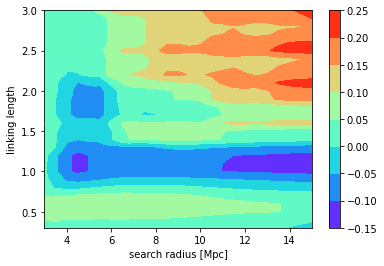

In [55]:
bar = plt.tricontourf(radius, lls, corrs, cmap = plt.cm.rainbow)
plt.colorbar(bar)
plt.xlabel('search radius [Mpc]')
plt.ylabel('linking length')

plt.savefig('correlation.png')

In [34]:
corrs = [np.corrcoef(x, fqs)[0, 1] for x in fofss]

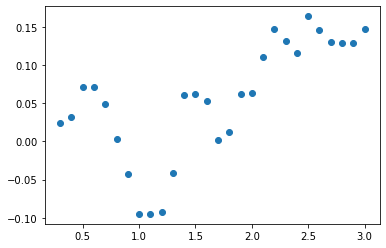

In [35]:
plt.scatter(np.arange(0.3, 3.1, 0.1), corrs)
plt.savefig('simulation_corr.png')

In [36]:
data = data[(data['z_true'] < 1.21) & (data['z_true'] > 0.79)]

In [41]:
# np.log10(cat.field('SFR_true')/10**cat.field('MASS_true')+1e-12)+9
ssfr = data['SFR_true']/10**data['MASS_true']+1e-12

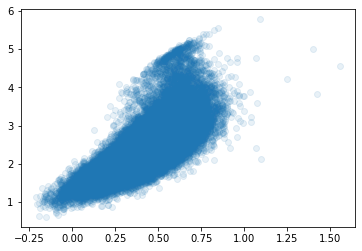

In [49]:
plt.scatter(data['MR_TOT_true'] - data['MKs_TOT_true'], data['MNUV_TOT_true'] - data['MR_TOT_true'], alpha = .1)
plt.savefig('ccd.png')


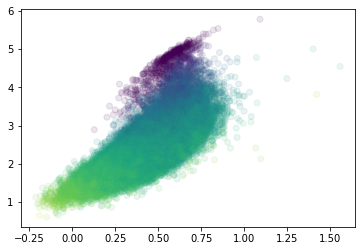

In [50]:
plt.scatter(data['MR_TOT_true'] - data['MKs_TOT_true'], data['MNUV_TOT_true'] - data['MR_TOT_true'], c = np.log10(ssfr), alpha = .1)

plt.savefig('ccd2.png')

ValueError: 'c' argument has 358150 elements, which is inconsistent with 'x' and 'y' with size 57687.

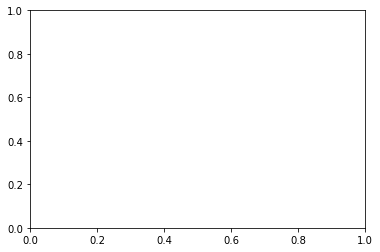

In [40]:
plt.scatter(data['MR_TOT_true'] - data['MKs_TOT_true'], data['MNUV_TOT_true'] - data['MR_TOT_true'], c = ssfr, alpha = .1)



In [67]:
age = cosmo.age(np.mean(data['z_true'])).to(u.yr).value
ssfr_mask  = data['SFR_true'] / 10**data['MASS_true'] < 1 / 3 / age

q_gal = data[ssfr_mask]
sf_gal = data[~ssfr_mask]

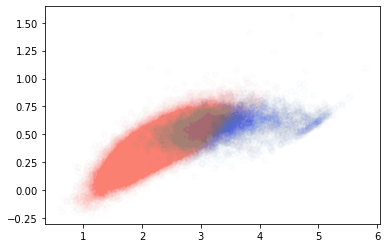

In [82]:
plt.scatter(q_gal['MNUV_TOT_true'] - q_gal['MR_TOT_true'], q_gal['MR_TOT_true'] - q_gal['MKs_TOT_true'], color = 'royalblue', alpha = .01)
plt.scatter(sf_gal['MNUV_TOT_true'] - sf_gal['MR_TOT_true'], sf_gal['MR_TOT_true'] - sf_gal['MKs_TOT_true'], color = 'salmon', alpha = .01)

plt.savefig('nuv-r-k.png')

In [73]:
q_gal.keys()

['ID',
 'RA_true',
 'DEC_true',
 'z_true',
 'z_dist',
 'MASS_true',
 'MASSBC03_true',
 'SFR_true',
 'MASS-WEIGHTED_AGE_true',
 'METALLICITY_true',
 'ZMED_sedf',
 'ZMED_UP_sedf',
 'ZMED_DOWN_sedf',
 'ZBEST_sedf',
 'ZBEST_UP_sedf',
 'ZBEST_DOWN_sedf',
 'MMED_sedf',
 'MMED_UP_sedf',
 'MMED_DOWN_sedf',
 'MBEST_sedf',
 'SFRMED_sedf',
 'SFRMED_UP_sedf',
 'SFRMED_DOWN_sedf',
 'LNUV_BEST_sedf',
 'LR_BEST_sedf',
 'LK_BEST_sedf',
 'MNUV_TOT_true',
 'MR_TOT_true',
 'MKs_TOT_true',
 'EXTLAW_BEST_sedf',
 'EBV_BEST_sedf',
 'u_TOT',
 'u_TOT_ERR',
 'u_TOTnoerr',
 'B_TOT',
 'B_TOT_ERR',
 'B_TOTnoerr',
 'V_TOT',
 'V_TOT_ERR',
 'V_TOTnoerr',
 'r_TOT',
 'r_TOT_ERR',
 'r_TOTnoerr',
 'ip_TOT',
 'ip_TOT_ERR',
 'ip_TOTnoerr',
 'zpp_TOT',
 'zpp_TOT_ERR',
 'zpp_TOTnoerr',
 'Y_TOT',
 'Y_TOT_ERR',
 'Y_TOTnoerr',
 'J_TOT',
 'J_TOT_ERR',
 'J_TOTnoerr',
 'H_TOT',
 'H_TOT_ERR',
 'H_TOTnoerr',
 'Ks_TOT',
 'Ks_TOT_ERR',
 'Ks_TOTnoerr',
 'IA427_TOT',
 'IA427_TOT_ERR',
 'IA427_TOTnoerr',
 'IA464_TOT',
 'IA464_TOT_ERR',
 

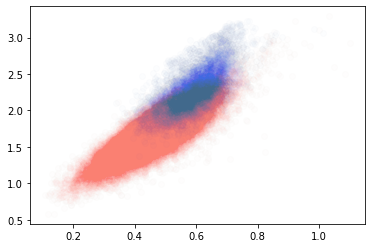

In [83]:
plt.scatter(sf_gal['J_TOTnoerr'] - sf_gal['Ks_TOTnoerr'], sf_gal['r_TOTnoerr'] - sf_gal['J_TOTnoerr'], color = 'salmon', alpha = .01)

plt.scatter(q_gal['J_TOTnoerr'] - q_gal['Ks_TOTnoerr'], q_gal['r_TOTnoerr'] - q_gal['J_TOTnoerr'], color = 'royalblue', alpha = .01)

plt.savefig('j-ks-r-j.png')

# Quiescent galaxy classification

In [57]:
# # import requests
# from requests import get

# with open('J_filter', "wb") as file:  
#         response = get('https://sites.astro.caltech.edu/~afaisst/files/cosmos_filter/J_wfcam.res')               
#         file.write(response.content)

In [58]:
# dat = Table.read('HorizonAGN_spectra.fits')

In [59]:
data.keys()

['ID',
 'RA_true',
 'DEC_true',
 'z_true',
 'z_dist',
 'MASS_true',
 'MASSBC03_true',
 'SFR_true',
 'MASS-WEIGHTED_AGE_true',
 'METALLICITY_true',
 'ZMED_sedf',
 'ZMED_UP_sedf',
 'ZMED_DOWN_sedf',
 'ZBEST_sedf',
 'ZBEST_UP_sedf',
 'ZBEST_DOWN_sedf',
 'MMED_sedf',
 'MMED_UP_sedf',
 'MMED_DOWN_sedf',
 'MBEST_sedf',
 'SFRMED_sedf',
 'SFRMED_UP_sedf',
 'SFRMED_DOWN_sedf',
 'LNUV_BEST_sedf',
 'LR_BEST_sedf',
 'LK_BEST_sedf',
 'MNUV_TOT_true',
 'MR_TOT_true',
 'MKs_TOT_true',
 'EXTLAW_BEST_sedf',
 'EBV_BEST_sedf',
 'u_TOT',
 'u_TOT_ERR',
 'u_TOTnoerr',
 'B_TOT',
 'B_TOT_ERR',
 'B_TOTnoerr',
 'V_TOT',
 'V_TOT_ERR',
 'V_TOTnoerr',
 'r_TOT',
 'r_TOT_ERR',
 'r_TOTnoerr',
 'ip_TOT',
 'ip_TOT_ERR',
 'ip_TOTnoerr',
 'zpp_TOT',
 'zpp_TOT_ERR',
 'zpp_TOTnoerr',
 'Y_TOT',
 'Y_TOT_ERR',
 'Y_TOTnoerr',
 'J_TOT',
 'J_TOT_ERR',
 'J_TOTnoerr',
 'H_TOT',
 'H_TOT_ERR',
 'H_TOTnoerr',
 'Ks_TOT',
 'Ks_TOT_ERR',
 'Ks_TOTnoerr',
 'IA427_TOT',
 'IA427_TOT_ERR',
 'IA427_TOTnoerr',
 'IA464_TOT',
 'IA464_TOT_ERR',
 

In [51]:
# dat['D']
dat['ID']

1
2
3
4
5
6
7
8
9
10
11


In [22]:
len(dat['log FLUX'][0])

1132

In [23]:
wave = np.linspace(506, 1e5, 1132) # Anstrom


In [35]:
NUV = ascii.read('NUV_filter')
r = ascii.read('r_filter')
J = ascii.read('J_filter')

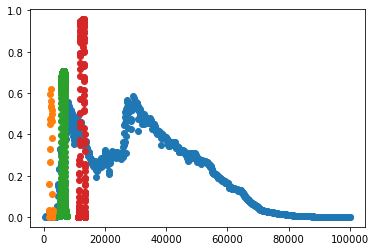

In [40]:
plt.scatter(wave, 10**dat['log FLUX'][-2])
plt.scatter(NUV['col1'], NUV['col2'])
plt.scatter(r['col1'], r['col2'])
plt.scatter(J['col1'], J['col2'])

In [49]:
r['col1']

5001.9
5006.1
5010.3
5014.4
5018.6
5022.8
5027.0
5031.1
5035.3
5039.5
5043.7


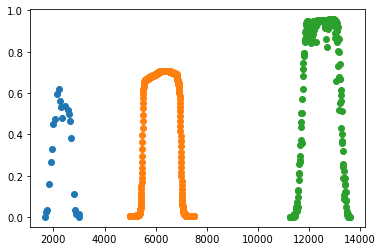

In [41]:
plt.scatter(NUV['col1'], NUV['col2'])
plt.scatter(r['col1'], r['col2'])
plt.scatter(J['col1'], J['col2'])

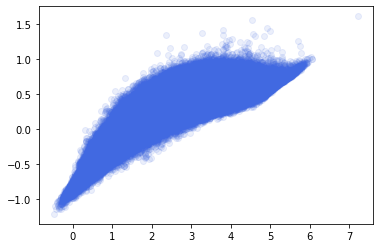

In [56]:
plt.scatter(data['MNUV_TOT_true'] - data['MR_TOT_true'], data['MR_TOT_true'] - data['MKs_TOT_true'], color = 'royalblue', alpha = .1)

# plt.xlim(-10, 20)
# plt.ylim(-10, 10)



(-10.0, 10.0)

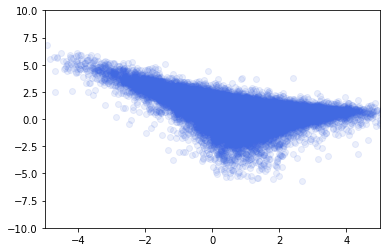

In [19]:
plt.scatter(data['r_TOT'] - data['J_TOT'], data['J_TOT'] - data['Ks_TOT'], color = 'royalblue', alpha = .1)

plt.xlim(-5, 5)
plt.ylim(-10, 10)



In [15]:
data['r_TOT']

24.71327
24.95515
24.52059
24.19773
22.39831
25.26337
25.32293
24.47547
23.26698
25.55991
23.23454
